# Load data

In [34]:
import gseapy as gp

In [35]:
import pandas as pd
import numpy as np
import anndata as ad
import matplotlib.pyplot as plt

In [36]:
import mygene
import networkx as nx

In [37]:
import scanpy as sc

# Read data

In [19]:
adata = sc.read('/storage/users/data/PANC/H5AD_file/adata_filtered_no2D_hvg_clust_time4.h5ad')

In [20]:
adata

AnnData object with n_obs × n_vars = 6235 × 1992
    obs: 'condition', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_cmo', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_scores', 'predicted_doublets', 'outlier', 'leiden', 't', 'seg', 'edge', 'milestones', 't_sd', '72->46_lindev_sel', '23->95_lindev_sel', '23->46_lindev_sel'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'CMO', 'gene_symbol', 'mito', 'ribo', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', '72->46_rss', 'p_val', 'A', 'fdr', 'st', 'signi'
    uns: '72->46_lindev_sel_colors', 'condition_colors', 'dendro_segments', 'draw_graph', 'graph', 'hvg', 'leiden', 'lei

In [21]:
#adata = ad.read_h5ad("/storage/users/data/PANC/H5AD_file/adata_filtered_no2D_hvg_clust_time_pub.h5ad")

In [22]:
## make trivial names unique
#adata.var_names = adata.var_names.astype(str)
#adata.var_names_make_unique()

In [23]:
adata

AnnData object with n_obs × n_vars = 6235 × 1992
    obs: 'condition', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_cmo', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_scores', 'predicted_doublets', 'outlier', 'leiden', 't', 'seg', 'edge', 'milestones', 't_sd', '72->46_lindev_sel', '23->95_lindev_sel', '23->46_lindev_sel'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'CMO', 'gene_symbol', 'mito', 'ribo', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', '72->46_rss', 'p_val', 'A', 'fdr', 'st', 'signi'
    uns: '72->46_lindev_sel_colors', 'condition_colors', 'dendro_segments', 'draw_graph', 'graph', 'hvg', 'leiden', 'lei

In [24]:
adata.obs['t']

barcode
AAACCCAGTAGGCTCC-1    0.001806
AAACCCAGTCGCAACC-1    0.172729
AAACCCATCCACAAGT-1    0.010820
AAACGCTTCACTACGA-1    0.004210
AAAGAACAGATACAGT-1    0.003463
                        ...   
TTTACTGTCATTACTC-1    1.162520
TTTCACAGTGATATAG-1    3.851607
TTTCACATCGATGCAT-1    2.962969
TTTCATGTCCCTCTAG-1    3.038554
TTTGACTGTTCCGGTG-1    3.829765
Name: t, Length: 6235, dtype: float64

In [25]:
adata.var_names

Index(['ENSG00000187608', 'ENSG00000224969', 'ENSG00000184163',
       'ENSG00000142609', 'ENSG00000287586', 'ENSG00000049246',
       'ENSG00000238290', 'ENSG00000204624', 'ENSG00000117122',
       'ENSG00000117115',
       ...
       'ENSG00000013619', 'ENSG00000029993', 'ENSG00000011677',
       'ENSG00000198883', 'ENSG00000182492', 'ENSG00000067842',
       'ENSG00000130821', 'ENSG00000198910', 'ENSG00000099721',
       'ENSG00000198899'],
      dtype='object', name='feature_id', length=1992)

In [26]:
#sc.pp.scale(adata, max_value=10)

## define new groups (leiden+t)

In [27]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex


Initial bin counts:
leiden_t_bin
0_t_0.0000-0.5000    2718
1_t_3.0000-3.5000    1081
3_t_1.0000-1.5000     625
2_t_3.5000-4.0000     583
1_t_2.5000-3.0000     530
1_t_2.0000-2.5000     137
2_t_3.0000-3.5000     129
2_t_2.5000-3.0000      70
2_t_2.0000-2.5000      49
3_t_0.5000-1.0000      49
3_t_1.5000-2.0000      48
1_t_1.0000-1.5000      47
1_t_1.5000-2.0000      47
0_t_0.5000-1.0000      39
1_t_0.5000-1.0000      25
2_t_1.5000-2.0000      20
3_t_2.0000-2.5000      18
3_t_0.0000-0.5000      11
2_t_1.0000-1.5000       4
0_t_1.0000-1.5000       4
3_t_2.5000-3.0000       1
Name: count, dtype: int64
Merged bin counts:
leiden_t_bin_merged
0_t_0.0000-0.5000    2718
1_t_3.0000-3.5000    1081
3_t_1.0000-1.5000     625
2_t_3.5000-4.0000     583
1_t_2.5000-3.0000     530
1_t_1.5000-2.5000     184
2_t_3.0000-3.5000     129
2_t_1.0000-2.5000      73
1_t_0.5000-1.5000      72
2_t_2.5000-3.0000      70
3_t_1.5000-2.5000      66
3_t_0.0000-1.0000      60
0_t_0.5000-1.5000      43
3_t_2.5000-3.0000 

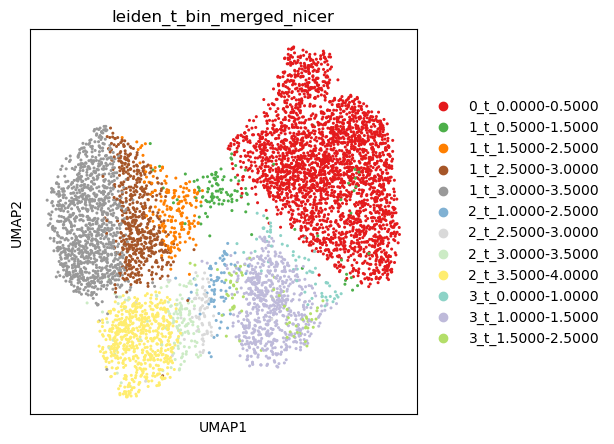

In [32]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex

###############################################
# Step 1: Fixed Binning
###############################################

bin_size = 0.3  # fixed bin width

def assign_leiden_t_bin(row, bin_size=0.5):
    # Compute fixed bin boundaries from the t-value
    bin_start = np.floor(row['t'] / bin_size) * bin_size
    bin_end = bin_start + bin_size
    return f"{row['leiden']}_t_{bin_start:.4f}-{bin_end:.4f}"

# Apply fixed binning to all cells
adata.obs['leiden_t_bin'] = adata.obs.apply(assign_leiden_t_bin, axis=1)
print("Initial bin counts:")
print(adata.obs['leiden_t_bin'].value_counts())

###############################################
# Step 2: Merge Small Fixed Bins
###############################################
# For each Leiden cluster, merge adjacent fixed bins (from leiden_t_bin)
# if their cell count is below a threshold (min_count).

def merge_fixed_bins_for_cluster(cluster_df, min_count=50):
    """
    cluster_df: adata.obs for one Leiden cluster.
    Returns a mapping (dict) from each fixed bin label (from leiden_t_bin) to a merged label.
    """
    counts = cluster_df['leiden_t_bin'].value_counts().to_dict()
    
    def parse_bin_average(label):
        parts = label.split('_')
        if len(parts) < 3:
            return 0.0
        time_range = parts[2]  # Expected format "start-end"
        if '-' not in time_range:
            return 0.0
        start, end = time_range.split('-')
        return (float(start) + float(end)) / 2
    
    fixed_bins = sorted(counts.keys(), key=parse_bin_average)
    
    merged_groups = []  # list of lists of fixed bin labels to be merged
    current_group = []
    current_total = 0
    for lbl in fixed_bins:
        cnt = counts[lbl]
        if not current_group:
            current_group = [lbl]
            current_total = cnt
        else:
            if current_total < min_count:
                current_group.append(lbl)
                current_total += cnt
            else:
                merged_groups.append(current_group)
                current_group = [lbl]
                current_total = cnt
    if current_group:
        merged_groups.append(current_group)
    
    merged_label_dict = {}
    for group in merged_groups:
        starts = []
        ends = []
        for lbl in group:
            parts = lbl.split('_')
            if len(parts) < 3:
                continue
            time_range = parts[2]
            if '-' not in time_range:
                continue
            s, e = time_range.split('-')
            starts.append(float(s))
            ends.append(float(e))
        if not starts or not ends:
            continue
        cluster_label = group[0].split('_')[0]
        merged_label = f"{cluster_label}_t_{min(starts):.4f}-{max(ends):.4f}"
        for lbl in group:
            merged_label_dict[lbl] = merged_label
    return merged_label_dict

merged_mapping_list = []
for cluster in adata.obs['leiden'].unique():
    cluster_df = adata.obs[adata.obs['leiden'] == cluster]
    mapping = merge_fixed_bins_for_cluster(cluster_df, min_count=50)
    merged_mapping_list.append(mapping)

merged_mapping = {}
for d in merged_mapping_list:
    merged_mapping.update(d)

adata.obs['leiden_t_bin_merged'] = adata.obs['leiden_t_bin'].map(merged_mapping)
print("Merged bin counts:")
print(adata.obs['leiden_t_bin_merged'].value_counts())

###############################################
# Step 3: Create Nicer Labels for Display
###############################################
def nicer_label(label):
    parts = label.split('_')
    leiden = parts[0]
    try:
        bin_range = parts[2]
    except IndexError:
        return label
    if '-' in bin_range:
        start, end = bin_range.split('-')
        if abs(float(start) - float(end)) < 1e-4:
            return f"{leiden}_t_{float(start):.4f}"
    return label

adata.obs['leiden_t_bin_merged_nicer'] = adata.obs['leiden_t_bin_merged'].apply(nicer_label)

###############################################
# Step 3.5: Adjust Small Merged Bins Across Cluster Boundaries
###############################################
# If a merged bin has a count below the threshold, reassign its cluster prefix.
min_count_threshold = 50
merged_counts = adata.obs['leiden_t_bin_merged'].value_counts().to_dict()

def adjust_label(label):
    cnt = merged_counts.get(label, 0)
    if cnt < min_count_threshold:
        if label.startswith("0_"):
            return "1" + label[1:]
        elif label.startswith("3_"):
            return "2" + label[1:]
    return label

adata.obs['leiden_t_bin_merged_nicer'] = adata.obs['leiden_t_bin_merged_nicer'].apply(adjust_label)

###############################################
# Step 4: Define Color Mapping
###############################################
def parse_merged_bin(label):
    parts = label.split('_')
    try:
        bin_range = parts[2]
    except IndexError:
        return 0.0
    if '-' in bin_range:
        start, end = bin_range.split('-')
        return (float(start) + float(end)) / 2
    else:
        return float(bin_range)

unique_merged = adata.obs['leiden_t_bin_merged_nicer'].unique()

# Split the labels into two groups based on their prefix.
# We want the final order: first labels starting with "0_", then "1_", then "3_", then "2_".
def get_prefix(label):
    return label.split('_')[0]

# Create a DataFrame of counts for sorting.
final_counts = adata.obs['leiden_t_bin_merged_nicer'].value_counts().reset_index()
final_counts.columns = ['label', 'count']

# Define the desired prefix order:
order_dict = {"0": 0, "1": 1, "3": 2, "2": 3}
final_counts['prefix'] = final_counts['label'].apply(get_prefix)
final_counts['order'] = final_counts['prefix'].map(lambda p: order_dict.get(p, 99))
final_counts_sorted = final_counts.sort_values(by=['order', 'label'])
print("Final merged label counts (sorted):")
print(final_counts_sorted[['label', 'count']])

# For color mapping, we still split by clusters: use Set1 for groups with prefix in ["0", "1"] and Set3 for those in ["2", "3"].
group_set1 = [group for group in unique_merged if get_prefix(group) in ['0', '1']]
group_set2 = [group for group in unique_merged if get_prefix(group) in ['2', '3']]

group_set1_sorted = sorted(group_set1, key=parse_merged_bin)
group_set2_sorted = sorted(group_set2, key=parse_merged_bin)

def assign_equally_spaced_colors(group_list, cmap, reverse=False):
    n = len(group_list)
    if n == 1:
        return {group_list[0]: rgb2hex(cmap(0.5))}
    colors = {}
    for i, group in enumerate(group_list):
        frac = i / (n - 1)
        if reverse:
            frac = 1 - frac
        colors[group] = rgb2hex(cmap(frac))
    return colors

group_to_color_set1 = assign_equally_spaced_colors(group_set1_sorted, plt.cm.Set1)
group_to_color_set2 = assign_equally_spaced_colors(group_set2_sorted, plt.cm.Set3)
group_to_color = {**group_to_color_set1, **group_to_color_set2}

print("Merged bin to color mapping:")
for group, color in group_to_color.items():
    print(group, color)

###############################################
# Step 5: Plot UMAP
###############################################
sc.pl.umap(adata, color='leiden_t_bin_merged_nicer', palette=group_to_color)


In [33]:
adata.write('/storage/users/data/PANC/H5AD_file/adata_filtered_no2D_hvg_clust_time4_clust_t-bin.h5ad')

# Individually define comparison : Define the Comparison and perform the GSEA analysis

### Create dictionary

In [220]:
# Extract Ensembl Gene IDs from the index
ensembl_ids = adata.var_names.tolist()
# Extract Ensembl Gene IDs from the index

# Initialize MyGene.info client
mg = mygene.MyGeneInfo()

# Query MyGene.info for mappings
print("Querying MyGene.info...")
results = mg.querymany(
    ensembl_ids,
    scopes="ensembl.gene",
    fields="symbol,entrezgene,uniprot",
    species="human"
)

# Initialize dictionaries for mappings
ensembl_to_uniprot = {}
ensembl_to_entrez = {}
ensembl_to_gene_name = {}

# Populate dictionaries
print("Processing results...")
for res in results:
    ensembl_id = res.get("query")
    if "notfound" in res:
        # If not found, skip this entry
        continue

    # Populate dictionaries with retrieved values
    ensembl_to_gene_name[ensembl_id] = res.get("symbol", ensembl_id)
    ensembl_to_entrez[ensembl_id] = res.get("entrezgene", ensembl_id)
    uniprot = res.get("uniprot", {}).get("Swiss-Prot", ensembl_id)
    ensembl_to_uniprot[ensembl_id] = uniprot

# Display a few dictionary entries as examples
print("\nSample mappings:")
print("Ensembl to Gene Symbol:", list(ensembl_to_gene_name.items())[:5])
print("Ensembl to Entrez Gene ID:", list(ensembl_to_entrez.items())[:5])
print("Ensembl to UniProt ID:", list(ensembl_to_uniprot.items())[:5])


Querying MyGene.info...
Processing results...

Sample mappings:
Ensembl to Gene Symbol: [('ENSG00000117122', 'MFAP2'), ('ENSG00000162545', 'CAMK2N1'), ('ENSG00000142798', 'HSPG2'), ('ENSG00000117318', 'ID3'), ('ENSG00000253368', 'TRNP1')]
Ensembl to Entrez Gene ID: [('ENSG00000117122', '4237'), ('ENSG00000162545', '55450'), ('ENSG00000142798', '3339'), ('ENSG00000117318', '3399'), ('ENSG00000253368', '388610')]
Ensembl to UniProt ID: [('ENSG00000117122', 'P55001'), ('ENSG00000162545', 'Q7Z7J9'), ('ENSG00000142798', 'P98160'), ('ENSG00000117318', 'Q02535'), ('ENSG00000253368', 'Q6NT89')]


## Compare the Clusters (milestones, leiden)

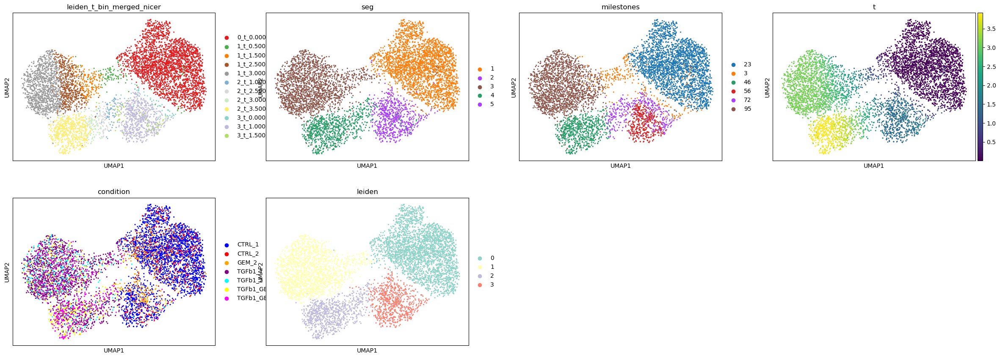

In [14]:
sc.pl.umap(adata, color=["leiden_t_bin_merged_nicer", "seg","milestones","t", "condition","leiden"])



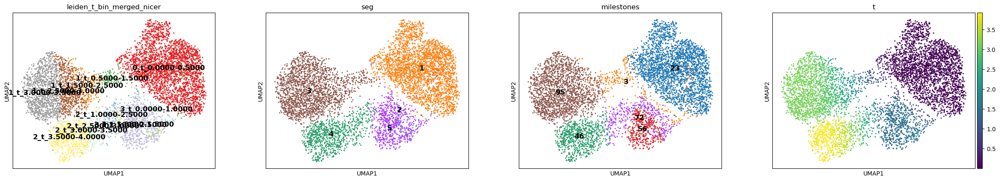

In [15]:
sc.pl.umap(
    adata, 
    color=["leiden_t_bin_merged_nicer","seg", "milestones", "t"], 
    legend_loc="on data",
    legend_fontsize=12,      # Adjust font size
    legend_fontweight="bold" # Adjust font weight
)


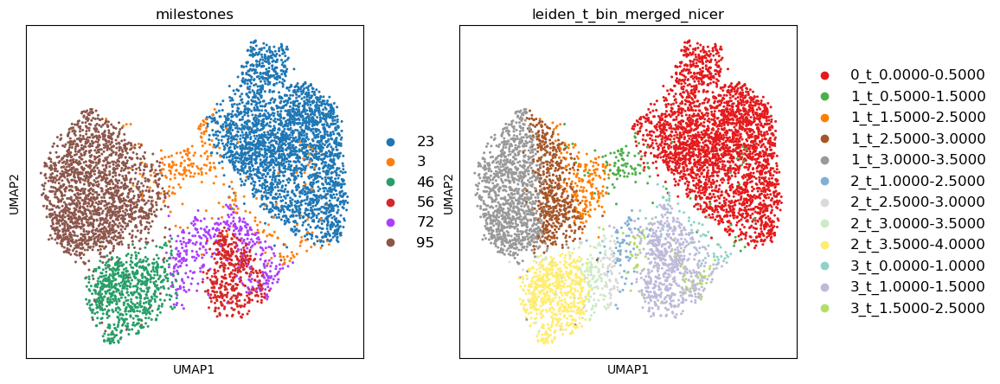

In [16]:
plt.rcParams['figure.figsize'] = [5, 5]

sc.pl.umap(
    adata, 
    color=["milestones", "leiden_t_bin_merged_nicer"], 
    #legend_loc="on data",
    legend_fontsize=12,      # Adjust font size
    legend_fontweight="bold" # Adjust font weight
)


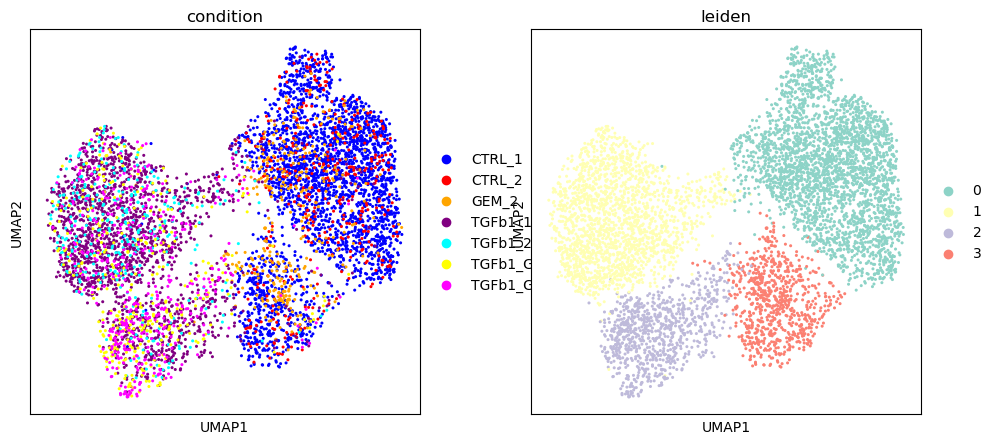

In [224]:
sc.pl.umap(adata, color=["condition","leiden"])

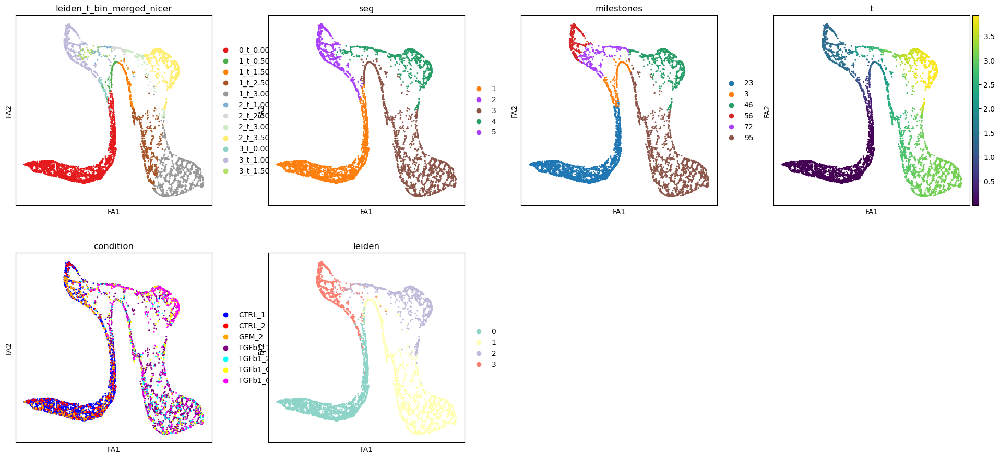

In [225]:
sc.pl.draw_graph(adata,color=["leiden_t_bin_merged_nicer","seg","milestones","t", "condition","leiden"])

#### Define the comparisons (milestones)

In [183]:
a1rootmilestone = ["193"]
a2selected_milestones = ["106", "89", "177", "51", "183"]

In [184]:
a1rootmilestone = ["88"]
a2selected_milestones = ["80", "21", "123", "62"]

#### Define the comparisons (leiden_t_bin)

In [231]:
pd.set_option('display.max_rows', None)
unique_milestones = adata.obs['leiden_t_bin_merged_nicer'].unique()
print(unique_milestones)

['0_t_0.0000-0.5000', '3_t_1.0000-1.5000', '3_t_0.0000-1.0000', '3_t_1.5000-2.5000', '2_t_3.5000-4.0000', ..., '1_t_3.0000-3.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000']
Length: 12
Categories (12, object): ['0_t_0.0000-0.5000', '1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', ..., '2_t_3.5000-4.0000', '3_t_0.0000-1.0000', '3_t_1.0000-1.5000', '3_t_1.5000-2.5000']


In [232]:
import numpy as np
import pandas as pd

# First, get the unique merged milestone labels (from your nicer-label column)
unique_milestones = list(adata.obs['leiden_t_bin_merged_nicer'].unique())
print("All unique milestones:")
print(unique_milestones)

# Define a helper to parse the average t value from a label (e.g., "0_t_0.0000-0.1000")
def parse_avg(label):
    # Expected label format: "X_t_start-end"
    try:
        parts = label.split('_')
        time_range = parts[2]  # "start-end"
        start, end = time_range.split('-')
        return (float(start) + float(end)) / 2
    except Exception as e:
        return 0

####################################
# Group 1: Leiden clusters 0 and 1
####################################
group1 = [m for m in unique_milestones if m.startswith('0_') or m.startswith('1_')]
# Sort by average t value
group1_sorted = sorted(group1, key=parse_avg)

# For Group 1, choose the root milestone as the smallest one from cluster 0.
a1rootmilestone_group1 = [m for m in group1_sorted if m.startswith('0_')][:1]
# The remaining milestones from group 1 will be the selected milestones.
a2selected_milestones_group1 = [m for m in group1_sorted if m not in a1rootmilestone_group1]

####################################
# Group 2: Leiden clusters 3 and 2
####################################
group2 = [m for m in unique_milestones if m.startswith('3_') or m.startswith('2_')]
# Sort by average t value
group2_sorted = sorted(group2, key=parse_avg)

# For Group 2, choose the root milestones as those from cluster 3.
a1rootmilestone_group2 = [m for m in group2_sorted if m.startswith('3_')]
# And the selected milestones as those from cluster 2.
a2selected_milestones_group2 = [m for m in group2_sorted if m.startswith('2_')]

# Print the autogenerated milestone lists
print("\nAutogenerated Milestones:")
print("Group 1 (e.g., from Leiden clusters 0 & 1):")
print("a1rootmilestone =", a1rootmilestone_group1)
print("a2selected_milestones =", a2selected_milestones_group1)

print("\nGroup 2 (e.g., from Leiden clusters 3 & 2):")
print("a1rootmilestone =", a1rootmilestone_group2)
print("a2selected_milestones =", a2selected_milestones_group2)


All unique milestones:
['0_t_0.0000-0.5000', '3_t_1.0000-1.5000', '3_t_0.0000-1.0000', '3_t_1.5000-2.5000', '2_t_3.5000-4.0000', '1_t_0.5000-1.5000', '2_t_1.0000-2.5000', '1_t_3.0000-3.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000']

Autogenerated Milestones:
Group 1 (e.g., from Leiden clusters 0 & 1):
a1rootmilestone = ['0_t_0.0000-0.5000']
a2selected_milestones = ['1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000']

Group 2 (e.g., from Leiden clusters 3 & 2):
a1rootmilestone = ['3_t_0.0000-1.0000', '3_t_1.0000-1.5000', '3_t_1.5000-2.5000']
a2selected_milestones = ['2_t_1.0000-2.5000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', '2_t_3.5000-4.0000']


In [257]:
a1rootmilestone_group1 = ['0_t_0.0000-0.5000']
a2selected_milestones_group2 = ['1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000']
a1rootmilestone_group2 = ['3_t_0.0000-1.0000']
a2selected_milestones_group2 = ['3_t_1.0000-1.5000', '3_t_1.5000-2.5000','2_t_1.0000-2.5000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', '2_t_3.5000-4.0000']
                                

# Iteration of GSEA

In [258]:
a1rootmilestone = a1rootmilestone_group2
a2selected_milestones = a2selected_milestones_group2


In [259]:
# Loop through each selected milestone for comparison
for milestone in a2selected_milestones:
    # Define group names
    group2 = f'root-{a1rootmilestone[0]}'
    group1 = f'selected-{milestone}'
    comparison = f'{group1}_vs_{group2}'
    
    print(f"Starting comparison: {comparison}")
    
    # Define milestone groups
    group1_milestones = a1rootmilestone
    group2_milestones = [milestone]

    # Label milestones for comparison
    def label_milestones(milestone):
        if milestone in group1_milestones:
            return group1
        elif milestone in group2_milestones:
            return group2
        else:
            return "NA"

    # Create a new column for comparison in `adata`
    adata.obs['compare_clusters'] = adata.obs['leiden_t_bin_merged_nicer'].map(label_milestones)

    # Subset the data for only the two groups
    bdata = adata[adata.obs.compare_clusters.isin([group1, group2])].copy()

    # Sort indices to define the direction of comparison
    sorted_indices = bdata.obs.sort_values(by='compare_clusters').index
    bdata = bdata[sorted_indices]

    # Convert to DataFrame and map Ensembl IDs to gene symbols
    expression_df = bdata.to_df().T
    mapping_dict = ensembl_to_gene_name
    new_index = expression_df.index.map(lambda x: mapping_dict.get(x, x))
    expression_df.index = new_index
    expression_df.index.name = 'gene_name'

    # Run GSEA
    res = gp.gsea(
        data=expression_df,
        #gene_sets="Reactome_2022",
        #gene_sets="GO_Biological_Process_2023",
        gene_sets="MSigDB_Hallmark_2020",
        cls=bdata.obs.compare_clusters,
        permutation_num=100000,
        outdir=None,
        min_size=10,
        max_size=100,
        method='log2_ratio_of_classes',
        threads=64
    )
    
    # Save the result
    base_path = "/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/"
    res_name = f"{base_path}gsea_{comparison}.csv"
    res.res2d.to_csv(res_name, index=False)
    print(f"Results saved for {comparison}: {res_name}")


Starting comparison: selected-3_t_1.0000-1.5000_vs_root-3_t_0.0000-1.0000
Results saved for selected-3_t_1.0000-1.5000_vs_root-3_t_0.0000-1.0000: /storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/gsea_selected-3_t_1.0000-1.5000_vs_root-3_t_0.0000-1.0000.csv
Starting comparison: selected-3_t_1.5000-2.5000_vs_root-3_t_0.0000-1.0000
Results saved for selected-3_t_1.5000-2.5000_vs_root-3_t_0.0000-1.0000: /storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/gsea_selected-3_t_1.5000-2.5000_vs_root-3_t_0.0000-1.0000.csv
Starting comparison: selected-2_t_1.0000-2.5000_vs_root-3_t_0.0000-1.0000
Results saved for selected-2_t_1.0000-2.5000_vs_root-3_t_0.0000-1.0000: /storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/gsea_selected-2_t_1.0000-2.5000_vs_root-3_t_0.0000-1.0000.csv
Starting comparison: selected-2_t_2.5000-3.0000_vs_root-3_t_0.0000-1.0000
Results saved for selected-2_t_2.5000-3.0000_vs_root-3_t_0.

In [ ]:
expression_df

In [236]:
res.res2d

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Epithelial Mesenchymal Transition,0.592807,1.592284,0.018409,0.255871,0.13747,15/32,23.18%,COL5A1;THBS1;SPOCK1;FN1;COL1A1;PTHLH;COL7A1;CR...
1,gsea,UV Response Dn,0.504653,1.411771,0.091882,0.468801,0.39166,9/14,41.87%,COL1A1;INPP4B;RUNX1;SDC2;APBB2;AKT3;DLG1;SERPI...
2,gsea,Hypoxia,0.351342,1.297337,0.178101,0.578172,0.57094,11/25,42.91%,COL5A1;LOX;SRPX;KLF7;TGFBI;IGFBP3;SDC2;NDRG1;P...
3,gsea,TGF-beta Signaling,0.453509,1.144449,0.315911,0.815341,0.75553,7/10,43.25%,THBS1;TGFBR1;PMEPA1;SMURF2;SERPINE1;BMPR2;SMURF1
4,gsea,KRAS Signaling Up,0.474013,1.144238,0.314016,0.65279,0.75573,3/10,22.49%,PLEK2;EMP1;IGFBP3
5,gsea,Glycolysis,0.502268,1.07155,0.367139,0.691357,0.82102,6/16,25.95%,COL5A1;EGLN3;SDC1;TGFBI;IGFBP3;SDC2
6,gsea,mTORC1 Signaling,0.474868,0.943835,0.545939,0.844075,0.90704,2/11,10.03%,TUBA4A;EGLN3
7,gsea,p53 Pathway,0.277031,0.926845,0.532606,0.769358,0.91554,6/17,50.17%,SDC1;CD82;PDGFA;NDRG1;TSC22D1;IER3
8,gsea,Apoptosis,-0.352581,-0.923283,0.551117,1.0,0.934832,7/11,21.45%,KRT18;HMGB2;DDIT3;SAT1;IFITM3;CAV1;HMOX1
9,gsea,Androgen Response,0.306304,0.867784,0.621807,0.782738,0.94186,6/11,44.64%,INPP4B;PMEPA1;NDRG1;ELL2;TSC22D1;ITGAV


In [156]:
# print head results
print(res.res2d.head(25))


    Name                               Term        ES       NES NOM p-val  \
0   gsea                    G2-M Checkpoint -0.587898 -1.385587  0.014665   
1   gsea                 TGF-beta Signaling -0.679969 -1.371066  0.008933   
2   gsea                    Mitotic Spindle  -0.57234 -1.365264  0.017116   
3   gsea                   mTORC1 Signaling -0.554265 -1.345481  0.023916   
4   gsea                  KRAS Signaling Up -0.699519 -1.343945  0.010371   
5   gsea                        E2F Targets -0.594352 -1.302818  0.030493   
6   gsea                         Glycolysis -0.521357 -1.281906  0.054394   
7   gsea                        p53 Pathway -0.650993 -1.221456  0.048265   
8   gsea                     UV Response Dn -0.655577 -1.217856  0.032272   
9   gsea                  Androgen Response -0.706993 -1.190827  0.065177   
10  gsea                            Hypoxia -0.547243 -1.153698  0.140077   
11  gsea  Epithelial Mesenchymal Transition -0.415964 -1.054487   0.35157   

Unique selected milestones: ['1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000']
Pathway color mapping:
Epithelial Mesenchymal Transition (0.12156862745098039, 0.4666666666666667, 0.7058823529411765)
UV Response Dn (1.0, 0.4980392156862745, 0.054901960784313725)
Hypoxia (0.17254901960784313, 0.6274509803921569, 0.17254901960784313)
TGF-beta Signaling (0.8392156862745098, 0.15294117647058825, 0.1568627450980392)
KRAS Signaling Up (0.5803921568627451, 0.403921568627451, 0.7411764705882353)
Plot saved as: /storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/figures/gsea-time_0_t_0.0000-0.5000_vs_1_t_3.0000-3.5000_20250305.png


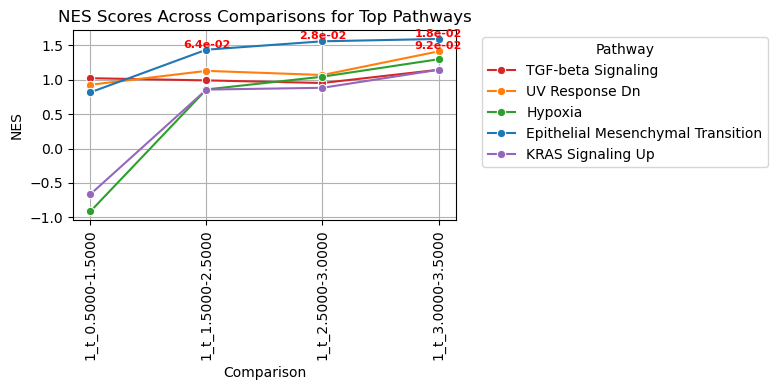

In [286]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Assume these were generated previously:
# a1rootmilestone_group1 = ['0_t_0.0000-0.5000', ...]
# a2selected_milestones_group1 = ['1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000']

# Convert the root milestone to a string (not a list)
root_milestone = a1rootmilestone_group1[0]  # e.g. '0_t_0.0000-0.5000'
selected_milestones = a2selected_milestones_group1  # list of strings

# Remove duplicates while preserving order
selected_milestones_unique = list(dict.fromkeys(selected_milestones))
print("Unique selected milestones:", selected_milestones_unique)

# Set base path for the CSV files
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/"

# Load the latest comparison file (using the last milestone in the unique list)
latest_file = f"{base_path}gsea_selected-{selected_milestones_unique[-1]}_vs_root-{root_milestone}.csv"
latest_res = pd.read_csv(latest_file)

# Extract the top 10 pathways based on NES from the latest result
top_10_pathways = latest_res.nlargest(5, "NES")["Term"]  # using 5 for example; adjust as needed

# Generate a stable color mapping for the pathway names.
# Use a fixed palette (here, "tab10") and assign one color per pathway.
unique_pathways = list(top_10_pathways.unique())
palette = sns.color_palette("tab10", n_colors=len(unique_pathways))
pathway_color_dict = dict(zip(unique_pathways, palette))
print("Pathway color mapping:")
for pathway, col in pathway_color_dict.items():
    print(pathway, col)

# Prepare a DataFrame to aggregate results from all comparisons
all_results = pd.DataFrame()

# Iterate through all unique comparisons and extract metrics for the top pathways
for milestone in selected_milestones_unique:
    file_path = f"{base_path}gsea_selected-{milestone}_vs_root-{root_milestone}.csv"
    try:
        res = pd.read_csv(file_path)
        # Filter for the top pathways (as determined from the latest file)
        filtered_res = res[res["Term"].isin(top_10_pathways)].copy()
        filtered_res["Comparison"] = milestone  # add a column for the comparison
        all_results = pd.concat([all_results, filtered_res], ignore_index=True)
    except FileNotFoundError:
        print(f"File not found: {file_path}")
        continue

# Set the Comparison column as an ordered categorical using the unique milestone order
all_results["Comparison"] = pd.Categorical(
    all_results["Comparison"],
    categories=selected_milestones_unique,
    ordered=True
)

# Prepare the data for plotting (selecting the relevant columns)
plot_data = all_results[["Term", "Comparison", "NES", "NOM p-val", "FDR q-val"]]

# Create a line plot for NES scores across comparisons for the top pathways
plt.figure(figsize=(8, 4))  # Adjust size for better readability
ax = sns.lineplot(
    data=plot_data,
    x="Comparison",
    y="NES",
    hue="Term",
    palette=pathway_color_dict,  # stable color mapping
    marker="o",
)
plt.title("NES Scores Across Comparisons for Top Pathways")
plt.xlabel("Comparison")
plt.ylabel("NES")
plt.legend(title="Pathway", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)  # Rotate x-axis labels vertically
plt.grid()
plt.tight_layout()

# Optionally, annotate points with scientific-format p-values if desired.
sig_threshold = 0.1
milestone_to_index = {milestone: i for i, milestone in enumerate(selected_milestones_unique)}
for term in plot_data["Term"].unique():
    term_data = plot_data[plot_data["Term"] == term]
    sig_data = term_data[term_data["NOM p-val"] < sig_threshold]
    for _, row in sig_data.iterrows():
        x_pos = milestone_to_index[row["Comparison"]]
        y_val = row["NES"]
        p_text = f"{row['NOM p-val']:.1e}"
        plt.text(x_pos, y_val, p_text, color='red', fontsize=8,
                 ha='center', va='bottom', fontweight='bold')

# Save the plot with a filename that includes the comparison and current date.
# Save the plot with a filename that includes the comparison and current date.
import os
output_dir = "/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/figures"
os.makedirs(output_dir, exist_ok=True)
current_date = datetime.now().strftime("%Y%m%d")
comparison_label = f"{root_milestone}_vs_{selected_milestones_unique[-1]}"
filename = os.path.join(output_dir, f"gsea-time_{comparison_label}_{current_date}.png")
plt.savefig(filename, dpi=600)
print("Plot saved as:", filename)

plt.show()


In [268]:
a1rootmilestone_group2 = ['3_t_0.0000-1.0000']
a2selected_milestones_group2 = ['3_t_1.0000-1.5000', '3_t_1.5000-2.5000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', '2_t_3.5000-4.0000']
                                

In [278]:
!pwd

/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum


Unique selected milestones: ['3_t_1.0000-1.5000', '3_t_1.5000-2.5000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', '2_t_3.5000-4.0000']
Pathway color mapping:
Epithelial Mesenchymal Transition (0.12156862745098039, 0.4666666666666667, 0.7058823529411765)
Glycolysis (1.0, 0.4980392156862745, 0.054901960784313725)
Hypoxia (0.17254901960784313, 0.6274509803921569, 0.17254901960784313)
UV Response Dn (0.8392156862745098, 0.15294117647058825, 0.1568627450980392)
KRAS Signaling Up (0.5803921568627451, 0.403921568627451, 0.7411764705882353)
p53 Pathway (0.5490196078431373, 0.33725490196078434, 0.29411764705882354)
E2F Targets (0.8901960784313725, 0.4666666666666667, 0.7607843137254902)
Plot saved as: /storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/figures/gsea-time_3_t_0.0000-1.0000_vs_2_t_3.5000-4.0000_20250305.png


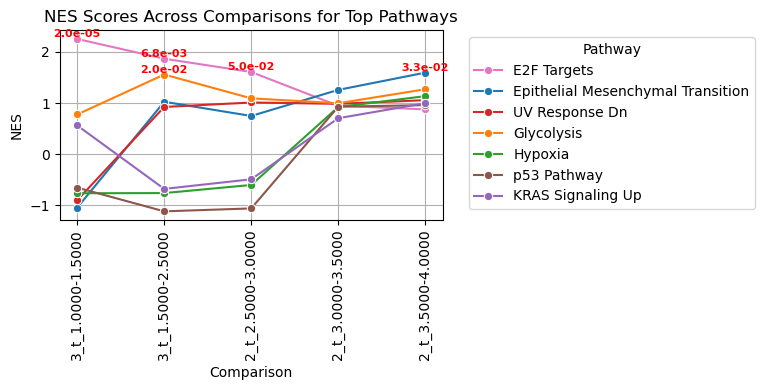

In [287]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Assume these were generated previously:
# a1rootmilestone_group1 = ['0_t_0.0000-0.5000', ...]
# a2selected_milestones_group1 = ['1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000']

# Convert the root milestone to a string (not a list)
root_milestone = a1rootmilestone_group2[0]  # e.g. '0_t_0.0000-0.5000'
selected_milestones = a2selected_milestones_group2  # list of strings

# Remove duplicates while preserving order
selected_milestones_unique = list(dict.fromkeys(selected_milestones))
print("Unique selected milestones:", selected_milestones_unique)

# Set base path for the CSV files
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/data/"

# Load the latest comparison file (using the last milestone in the unique list)
latest_file = f"{base_path}gsea_selected-{selected_milestones_unique[-1]}_vs_root-{root_milestone}.csv"
latest_res = pd.read_csv(latest_file)

# Extract the top 10 pathways based on NES from the latest result
top_10_pathways = latest_res.nlargest(7, "NES")["Term"]  # using 5 for example; adjust as needed

# Generate a stable color mapping for the pathway names.
# Use a fixed palette (here, "tab10") and assign one color per pathway.
unique_pathways = list(top_10_pathways.unique())
palette = sns.color_palette("tab10", n_colors=len(unique_pathways))
pathway_color_dict = dict(zip(unique_pathways, palette))
print("Pathway color mapping:")
for pathway, col in pathway_color_dict.items():
    print(pathway, col)

# Prepare a DataFrame to aggregate results from all comparisons
all_results = pd.DataFrame()

# Iterate through all unique comparisons and extract metrics for the top pathways
for milestone in selected_milestones_unique:
    file_path = f"{base_path}gsea_selected-{milestone}_vs_root-{root_milestone}.csv"
    try:
        res = pd.read_csv(file_path)
        # Filter for the top pathways (as determined from the latest file)
        filtered_res = res[res["Term"].isin(top_10_pathways)].copy()
        filtered_res["Comparison"] = milestone  # add a column for the comparison
        all_results = pd.concat([all_results, filtered_res], ignore_index=True)
    except FileNotFoundError:
        print(f"File not found: {file_path}")
        continue

# Set the Comparison column as an ordered categorical using the unique milestone order
all_results["Comparison"] = pd.Categorical(
    all_results["Comparison"],
    categories=selected_milestones_unique,
    ordered=True
)

# Prepare the data for plotting (selecting the relevant columns)
plot_data = all_results[["Term", "Comparison", "NES", "NOM p-val", "FDR q-val"]]

# Create a line plot for NES scores across comparisons for the top pathways
plt.figure(figsize=(8, 4))  # Adjust size for better readability
ax = sns.lineplot(
    data=plot_data,
    x="Comparison",
    y="NES",
    hue="Term",
    palette=pathway_color_dict,  # stable color mapping
    marker="o",
)
plt.title("NES Scores Across Comparisons for Top Pathways")
plt.xlabel("Comparison")
plt.ylabel("NES")
plt.legend(title="Pathway", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)  # Rotate x-axis labels vertically
plt.grid()
plt.tight_layout()

# Optionally, annotate points with scientific-format p-values if desired.
sig_threshold = 0.1
milestone_to_index = {milestone: i for i, milestone in enumerate(selected_milestones_unique)}
for term in plot_data["Term"].unique():
    term_data = plot_data[plot_data["Term"] == term]
    sig_data = term_data[term_data["NOM p-val"] < sig_threshold]
    for _, row in sig_data.iterrows():
        x_pos = milestone_to_index[row["Comparison"]]
        y_val = row["NES"]
        p_text = f"{row['NOM p-val']:.1e}"
        plt.text(x_pos, y_val, p_text, color='red', fontsize=8,
                 ha='center', va='bottom', fontweight='bold')

# Save the plot with a filename that includes the comparison and current date.
import os
output_dir = "/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum/figures"
os.makedirs(output_dir, exist_ok=True)
current_date = datetime.now().strftime("%Y%m%d")
comparison_label = f"{root_milestone}_vs_{selected_milestones_unique[-1]}"
filename = os.path.join(output_dir, f"gsea-time_{comparison_label}_{current_date}.png")
plt.savefig(filename, dpi=600)
print("Plot saved as:", filename)

plt.show()


In [564]:
!pwd

/storage/users/job37yv/Projects/single-cell_samantha/code/scripts_praktikum


In [65]:
bdata = adata.copy()
bdata.var_names = bdata.var['gene_symbol']

/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/anndata/_core/anndata.py:844: UserWarning: 
AnnData expects .var.index to contain strings, but got values like:
    ['ISG15', '', 'C1QTNF12', 'CFAP74', '']

    Inferred to be: categorical

  names = self._prep_dim_index(names, "var")


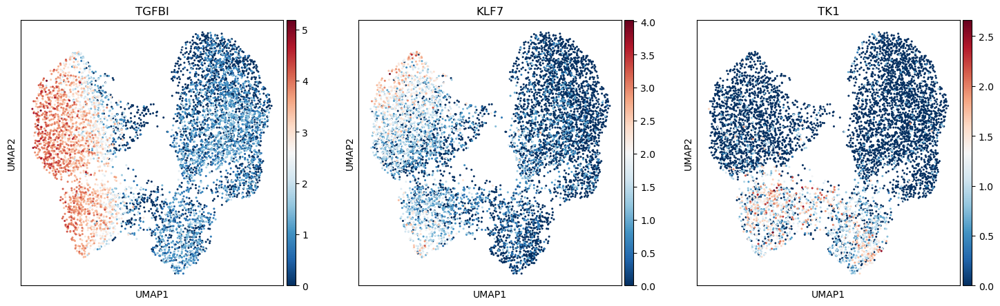

In [66]:
sc.pl.umap(bdata,color=['TGFBI','KLF7', 'TK1' ],cmap="RdBu_r")

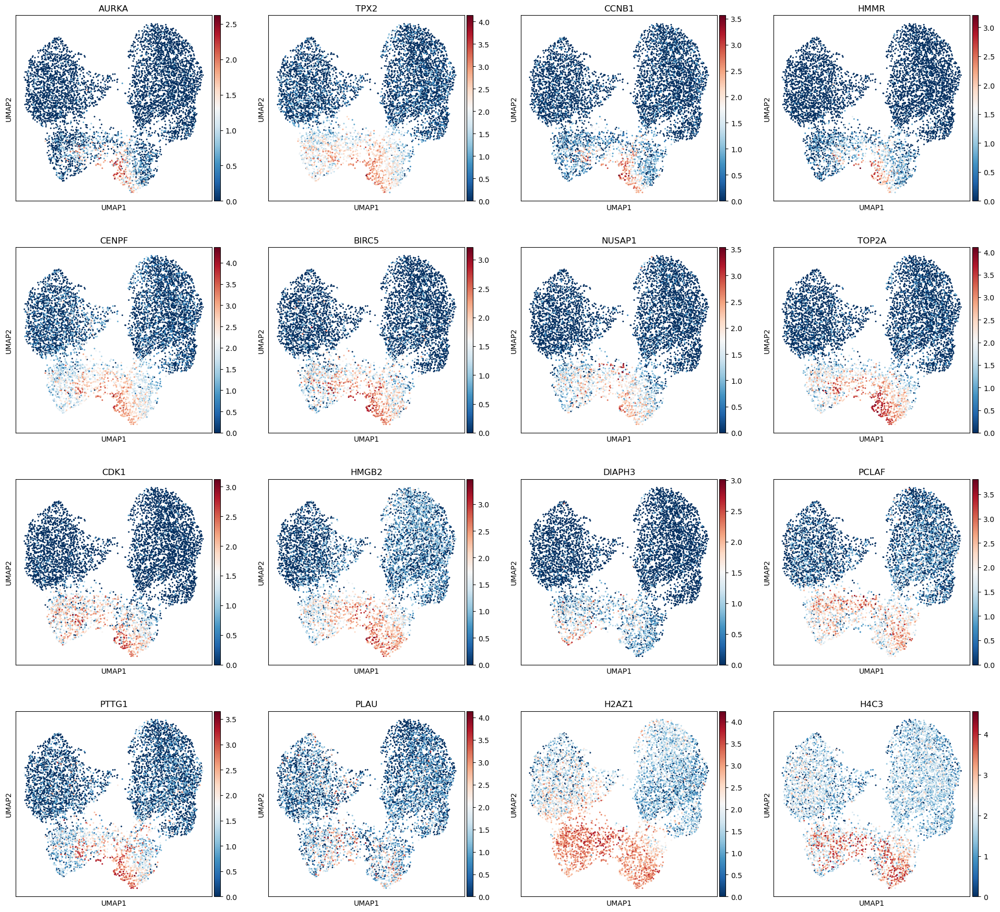

In [92]:
sc.pl.umap(bdata,color=['AURKA',  'TPX2', 'CCNB1' , 'HMMR' ,'CENPF', 'BIRC5', 
                        'NUSAP1','TOP2A',  'PTTG1','CDK1', 'HMGB2' , 'DIAPH3', 'PCLAF',
                        'TK1', 'PLAU', 'H2AZ1' , 'H4C3' ],cmap="RdBu_r")

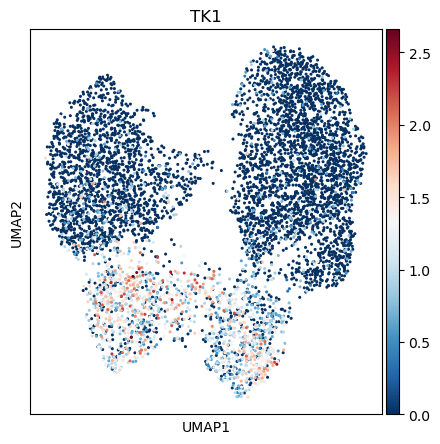

In [91]:
sc.pl.umap(bdata,color=['TK1' ],cmap="RdBu_r")

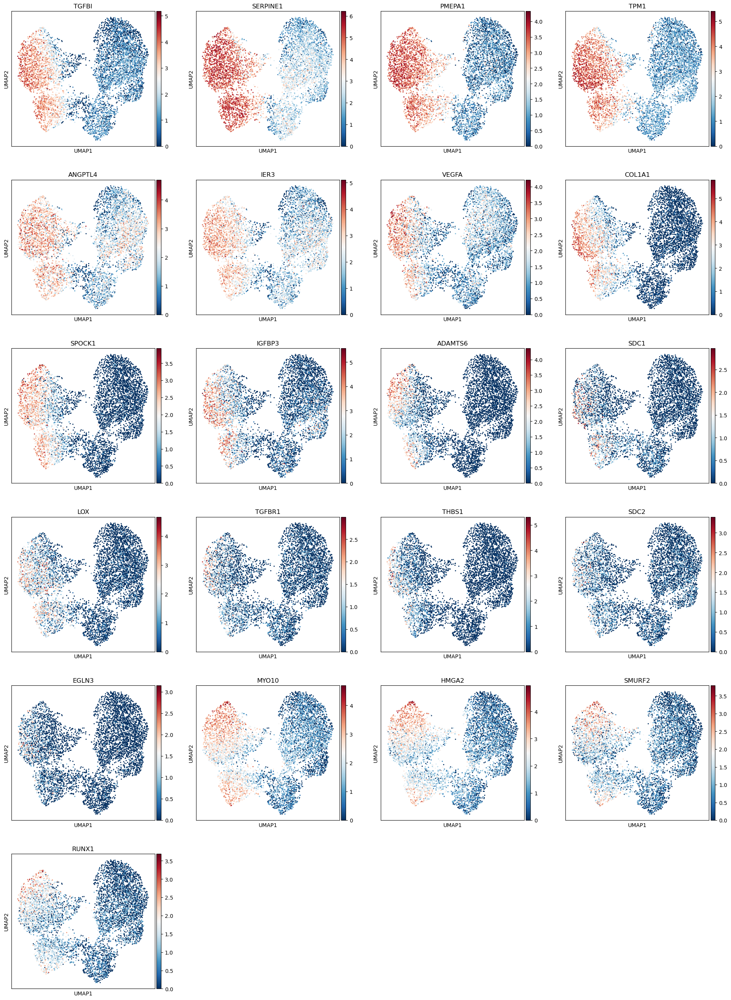

In [115]:
sc.pl.umap(
    bdata,
    color=[
        'TGFBI', 'SERPINE1',  'PMEPA1',  'TPM1', 'ANGPTL4', 'IER3', 'VEGFA',  'COL1A1',   'SPOCK1',    
        'IGFBP3', 'ADAMTS6',  'SDC1',  'LOX',  'TGFBR1', 'THBS1', 'SDC2', 'EGLN3', 'MYO10', 'HMGA2',
        'SMURF2', 'RUNX1'
    ],
    cmap="RdBu_r"
)

In [ ]:
sc.pl.umap(bdata,color=['', '', '' , '', '', , '', '', '', '', 'THBS1' ],cmap="RdBu_r")

KeyError: 'Could not find key EGFR in .var_names or .obs.columns.'

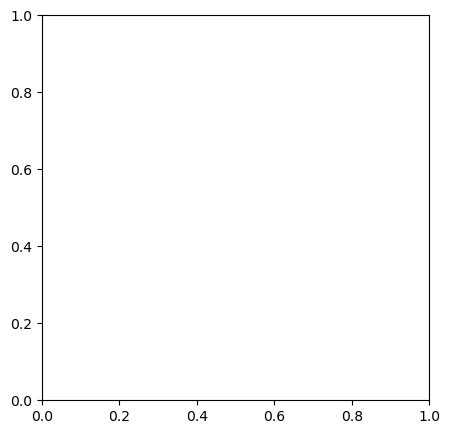

In [126]:
sc.pl.umap(
    bdata,
    color=[
       'EGFR'
    ],
    cmap="RdBu_r"
)


   #     'KRAS', 'TP53', 'CDKN2A', 'SMAD4', 'CA19-9', 
   #     'BRCA1', 'BRCA2', 'PALB2', 'GATA6', 'MYC', 
    #    'EGFR', 'CEACAM1', 'CEACAM6', 'S100A2', 'S100A4', 
    #    'MUC1', 'MUC4', 'MUC16', 'CD44', 'ALDH1'


In [565]:
comparison

'1resistant_vs_2non-reistant'

In [567]:
from datetime import datetime

# Define the base path and comparison
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/"
base_path_fig = "/storage/users/job37yv/Projects/single-cell_samantha/figures/res_gsea_hallmark/"

# Get the current date in YYYY-MM-DD format
current_date = datetime.now().strftime("%Y-%m-%d")

# Construct the file path with the date
path = f"{base_path}res_gsea_reactome2_leiden3vs0_{current_date}.csv"

# write to file location
res.res2d.to_csv(path, index=False)

print(f"Generated file path: {path}")


Generated file path: /storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/res_gsea_reactome2_leiden3vs0_2025-01-10.csv


0       Transcriptional Regulation By TP53 R-HSA-3700989
1                      RHO GTPase Effectors R-HSA-195258
2                        Cell Cycle, Mitotic R-HSA-69278
3                       Mitotic Prometaphase R-HSA-68877
4                     Cell Cycle Checkpoints R-HSA-69620
                             ...                        
214    Regulation Of IGF Transport And Uptake By IGFB...
215              Neurexins And Neuroligins R-HSA-6794361
216                      ECM Proteoglycans R-HSA-3000178
217                    Signaling By NOTCH1 R-HSA-1980143
218    Protein-protein Interactions At Synapses R-HSA...
Name: Term, Length: 219, dtype: object
Generated file path: /storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/res_gsea_reactome2_leiden3vs0_2025-01-10.csv


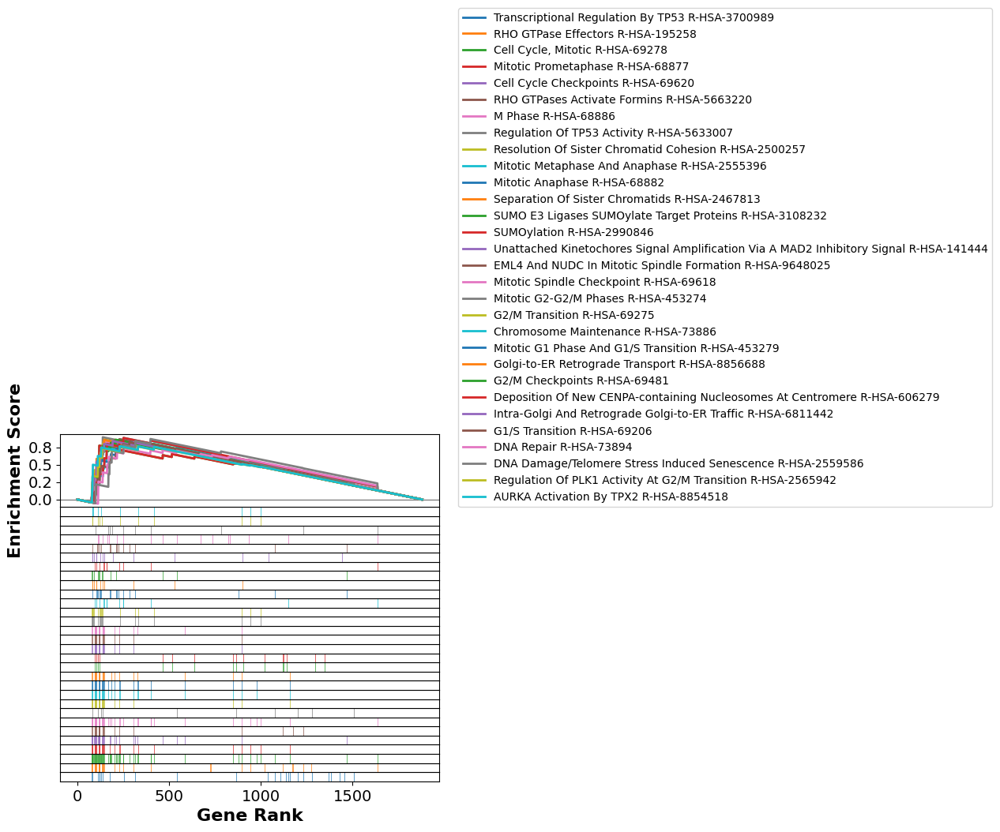

In [568]:

# Visualize the top pathways
terms = res.res2d.Term
print(terms)
axs = res.plot(terms[:30], show_ranking=False, legend_kws={'loc': (1.05, 0)}, )

# Assuming axs is a matplotlib Axes object, you save the figure like this:
plt.savefig(base_path_fig + f"res_gsea_{comparison}_{current_date}.png", bbox_inches='tight')

print(f"Generated file path: {path}")

### Get the genes in the pathway

In [569]:
data = res.res2d
type(data)
data

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Transcriptional Regulation By TP53 R-HSA-3700989,0.746148,2.545085,0.0,0.0,0.0,10/26,16.86%,CDC25C;CDK1;AURKA;BIRC5;CCNB1;TPX2;BRIP1;CCNE2...
1,gsea,RHO GTPase Effectors R-HSA-195258,0.818143,2.532133,0.0,0.0,0.0,25/38,13.40%,SPC25;KIF14;CDC25C;KIF2C;KNL1;BUB1B;NUF2;CDCA8...
2,gsea,"Cell Cycle, Mitotic R-HSA-69278",0.803887,2.445504,0.0,0.00077,0.001,51/65,17.61%,SPC25;CDC25C;NEK2;KIF2C;CDK1;HMMR;GTSE1;KNL1;B...
3,gsea,Mitotic Prometaphase R-HSA-68877,0.841351,2.427933,0.0,0.000578,0.001,26/34,12.29%,SPC25;NEK2;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BU...
4,gsea,Cell Cycle Checkpoints R-HSA-69620,0.83329,2.392442,0.001789,0.000462,0.001,31/39,12.23%,SPC25;CDC25C;KIF2C;CDK1;GTSE1;KNL1;BUB1B;NUF2;...
...,...,...,...,...,...,...,...,...,...,...
214,gsea,Regulation Of IGF Transport And Uptake By IGFB...,-0.176026,-0.372678,1.0,1.0,1.0,28/28,82.71%,PAPPA;SCG2;IGFBP6;CP;PAPPA2;SERPINA1;APOE;IGFB...
215,gsea,Neurexins And Neuroligins R-HSA-6794361,-0.268058,-0.367146,0.984756,1.0,1.0,11/11,73.40%,LRRTM4;EPB41;NLGN1;NRXN3;SYT1;SHANK2;GRIN2A;AP...
216,gsea,ECM Proteoglycans R-HSA-3000178,-0.220557,-0.34421,1.0,1.0,1.0,12/12,78.14%,SPARC;BGN;HSPG2;SERPINE1;TGFB3;VCAN;ITGAV;NCAN...
217,gsea,Signaling By NOTCH1 R-HSA-1980143,-0.192513,-0.331859,1.0,1.0,1.0,10/10,80.90%,CNTN1;DNER;MAML3;HDAC8;JAG1;HDAC9;MAML2;HEY1;T...


In [570]:
# Extracting lead_genes
lead_genes = data['Lead_genes'].head(15)

# Printing the lead_genes
for i, genes in enumerate(lead_genes, 1):
    print(f"Row {i} Lead Genes: {genes}")

Row 1 Lead Genes: CDC25C;CDK1;AURKA;BIRC5;CCNB1;TPX2;BRIP1;CCNE2;E2F7;CDKN1A
Row 2 Lead Genes: SPC25;KIF14;CDC25C;KIF2C;KNL1;BUB1B;NUF2;CDCA8;BUB1;CENPE;CENPI;DIAPH3;ZWINT;BIRC5;CENPK;CDC20;PRC1;SGO2;KIF18A;CENPF;CENPU;CENPA;SPDL1;CENPP;H2AC20
Row 3 Lead Genes: SPC25;CDC25C;NEK2;KIF2C;CDK1;HMMR;GTSE1;KNL1;BUB1B;NUF2;CDCA8;BUB1;TOP2A;CENPE;KIF23;CENPI;RRM2;AURKA;CDC6;ZWINT;BIRC5;CCNB1;CENPK;CDC20;MYBL2;TK1;TPX2;CCNB2;SGO2;KIF18A;CENPF;CENPU;CENPA;LMNB1;CCNE2;SMC4;MCM4;PTTG1;SPDL1;DBF4;TYMS;DHFR;CENPP;TUBA4A;PRIM2;H2AC20;GMNN;DYNC1I1;CDKN1A;UBE2S;TUBB4B
Row 4 Lead Genes: SPC25;NEK2;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BUB1;CENPE;CENPI;ZWINT;BIRC5;CCNB1;CENPK;CDC20;CCNB2;SGO2;KIF18A;CENPF;CENPU;CENPA;SMC4;SPDL1;CENPP;TUBA4A
Row 5 Lead Genes: SPC25;CDC25C;KIF2C;CDK1;GTSE1;KNL1;BUB1B;NUF2;CDCA8;BUB1;CENPE;CENPI;CDC6;CLSPN;ZWINT;BIRC5;CCNB1;CENPK;CDC20;CCNB2;SGO2;KIF18A;BRIP1;CENPF;CENPU;CENPA;CCNE2;MCM4;SPDL1;DBF4;CENPP
Row 6 Lead Genes: SPC25;KIF2C;KNL1;BUB1B;NUF2;CDCA8;BUB1;CENPE;CENPI;DIAPH3

In [571]:
from datetime import datetime

# Assuming `data` is your DataFrame and `comparison` is defined
# Extract the top 15 lead genes
lead_genes = data['Lead_genes'].head(15)

# Define the base path for saving the gene list
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/"

# Get the current date in YYYY-MM-DD format
current_date = datetime.now().strftime("%Y-%m-%d")

# Construct the file path for saving the lead genes
gene_list_path = f"{base_path}lead_genes_leiden2vs1_reactome_big_{comparison}_{current_date}.csv"

# Write the lead genes to a file
with open(gene_list_path, "w") as file:
    file.write("Top 15 Lead Genes:\n")
    for i, genes in enumerate(lead_genes, 1):
        file.write(f"Row {i}: {genes}\n")

print(f"Lead genes saved to: {gene_list_path}")


Lead genes saved to: /storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/lead_genes_leiden2vs1_reactome_big_1resistant_vs_2non-reistant_2025-01-10.csv


## Print Heatmap

### Barcode annotation or leiden

In [411]:
from gseapy import heatmap

# Plotting heatmap for a specific pathway
i = 1  # Index of the pathway to visualize

# Translate Barcode to Leiden Clusters
barcode_to_leiden = adata.obs['leiden'].to_dict()  # Map barcodes to Leiden clusters

# Extract barcodes from GSEA results
barcodes = res.res2d.columns.tolist()

# Print terms (optional)
terms = res.res2d.Term.tolist()

# Extract lead genes for the selected pathway
genes = res.res2d.Lead_genes[i].split(";")  # Ensure ";" is the correct separator

# Prepare the heatmap DataFrame
df_heat = res.heatmat.loc[genes]  # Extract expression data for the lead genes

# Map barcodes to Leiden clusters
new_columns = df_heat.columns.map(barcode_to_leiden.get)

# Assign the new column names back to the DataFrame
df_heat.columns = new_columns



In [412]:

# Calculate the average expression per Leiden group
average_expression_per_leiden = df_heat.groupby(df_heat.columns, axis=1).mean()

# Print the average expression for debugging
print("\nAverage expression per Leiden group:")
print(average_expression_per_leiden)





Average expression per Leiden group:
barcode           1         2
gene_name                    
SPC25      0.014699  0.681332
KIF2C      0.021883  0.651794
NEK2       0.011205  0.316978
CDK1       0.057704  1.434755
NUF2       0.028263  0.509438
BUB1B      0.026272  0.409030
KNL1       0.060005  0.783765
BUB1       0.034671  0.438217
ZWINT      0.073624  0.859273
BIRC5      0.125350  1.357847
KIF18A     0.024647  0.255900
CDCA8      0.052275  0.522197
CCNB2      0.035162  0.349743
CENPU      0.049205  0.444801
CDC20      0.036397  0.306622
CCNB1      0.085691  0.706075
CENPE      0.053872  0.396112
CENPF      0.267057  1.831093
CENPI      0.067850  0.459048
CENPA      0.126216  0.835259
SGO2       0.121738  0.750573
CENPK      0.308547  1.596305
SMC4       0.333358  1.521699


/tmp/ipykernel_566471/1467009363.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  average_expression_per_leiden = df_heat.groupby(df_heat.columns, axis=1).mean()


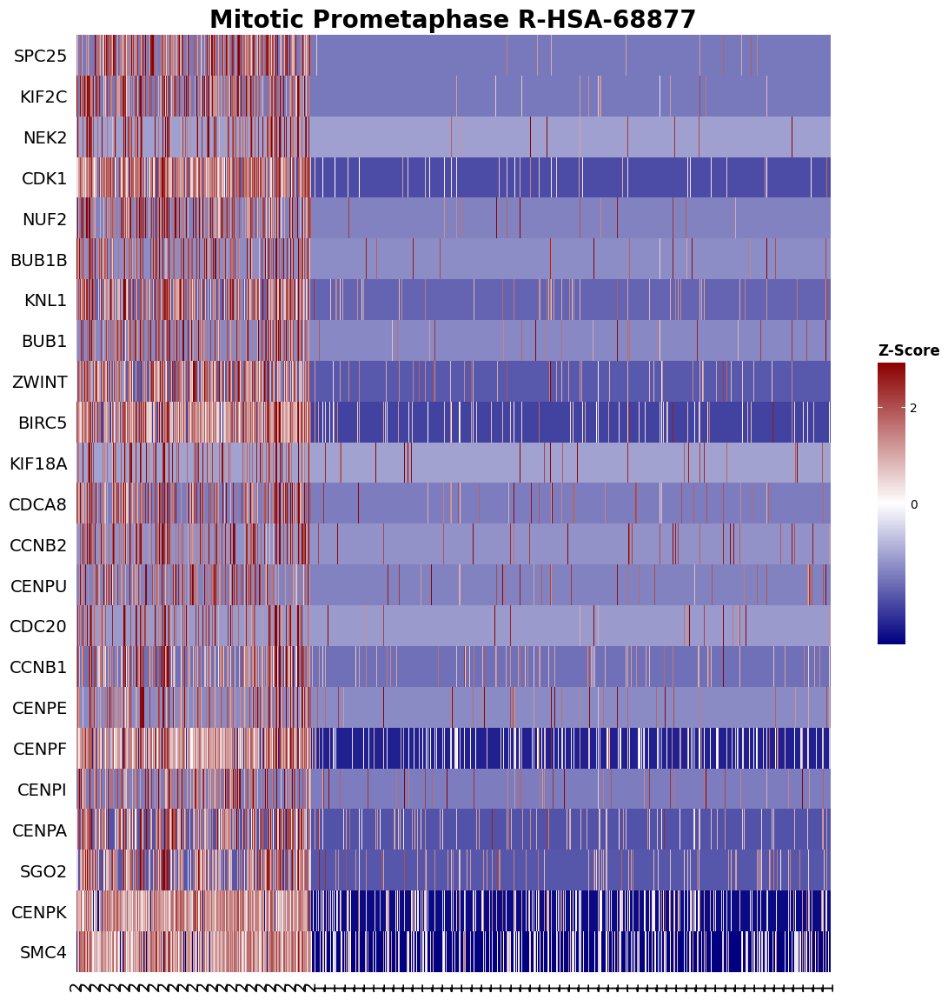

In [413]:
# Plot the heatmap
ax = heatmap(df=df_heat, z_score=0, title=terms[i], figsize=(14, 14))

#help(gp.gsea)

## Plot Bubbleplot

In [414]:
# Select the first 15 pathways by their original index order
top_15_res = res.res2d.iloc[:15]

# Display the top 15 pathways by original index
print("Top 15 pathways by original index:")
print(top_15_res)

Top 15 pathways by original index:
    Name                                               Term        ES  \
0   gsea   Transcriptional Regulation By TP53 R-HSA-3700989  0.776767   
1   gsea                   Mitotic Prometaphase R-HSA-68877  0.855741   
2   gsea                  RHO GTPase Effectors R-HSA-195258  0.811376   
3   gsea         RHO GTPases Activate Formins R-HSA-5663220  0.871977   
4   gsea                                M Phase R-HSA-68886  0.811724   
5   gsea  Resolution Of Sister Chromatid Cohesion R-HSA-...   0.88685   
6   gsea      Separation Of Sister Chromatids R-HSA-2467813  0.861822   
7   gsea                        G2/M Transition R-HSA-69275  0.860248   
8   gsea                Mitotic G2-G2/M Phases R-HSA-453274  0.860248   
9   gsea  EML4 And NUDC In Mitotic Spindle Formation R-H...   0.88165   
10  gsea  Unattached Kinetochores Signal Amplification V...   0.88165   
11  gsea       Mitotic Metaphase And Anaphase R-HSA-2555396  0.840274   
12  gsea        

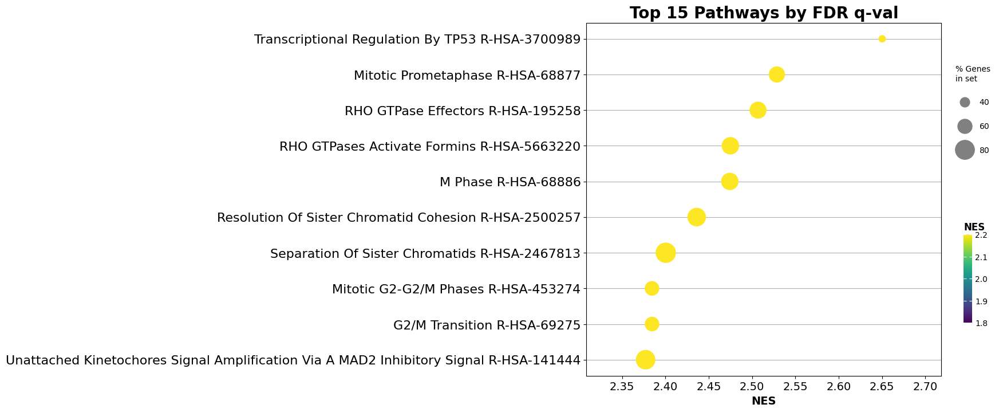

In [415]:
import matplotlib.pyplot as plt
from gseapy import dotplot

# Select the first 15 pathways by their original index order
top_15_res = res.res2d.iloc[:15]

# Find the minimum NES value to include all data
min_nes = top_15_res['NES'].min()

# Plotting bubble plot for the top 15 pathways
ax = dotplot(
    df=top_15_res,
    column='NES',         # Color bubbles by Normalized Enrichment Score
    title='Top 15 Pathways by FDR q-val',
    cmap=plt.cm.viridis,  # Colormap for coloring NES values
    size=5,               # Adjust the size of the bubbles
    figsize=(10, 8),      # Set figure size for better readability
    cutoff=-10,    # Ensure all NES values are included
    thresh=-5,
    n_terms=15
)

# Show the plot
plt.show()


In [416]:
import matplotlib.pyplot as plt
from gseapy import dotplot

# Select the first 15 pathways by their original index order
top_15_res = res.res2d.iloc[:15]
top_15_res

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Transcriptional Regulation By TP53 R-HSA-3700989,0.776767,2.650127,0.0,0.001491,0.001,8/26,7.16%,CDK1;CDC25C;BRIP1;BIRC5;CCNE2;TPX2;CCNB1;AURKA
1,gsea,Mitotic Prometaphase R-HSA-68877,0.855741,2.528537,0.0,0.001491,0.002,23/34,8.76%,SPC25;KIF2C;NEK2;CDK1;NUF2;BUB1B;KNL1;BUB1;ZWI...
2,gsea,RHO GTPase Effectors R-HSA-195258,0.811376,2.506816,0.0,0.001988,0.002,27/38,15.36%,SPC25;KIF2C;CDC25C;NUF2;BUB1B;DIAPH3;KNL1;BUB1...
3,gsea,RHO GTPases Activate Formins R-HSA-5663220,0.871977,2.474872,0.0,0.001491,0.002,19/26,8.14%,SPC25;KIF2C;NUF2;BUB1B;DIAPH3;KNL1;BUB1;ZWINT;...
4,gsea,M Phase R-HSA-68886,0.811724,2.474216,0.003559,0.001789,0.002,32/44,14.38%,SPC25;KIF2C;NEK2;CDK1;KIF23;NUF2;BUB1B;KNL1;BU...
5,gsea,Resolution Of Sister Chromatid Cohesion R-HSA-...,0.88685,2.436002,0.0,0.001491,0.002,21/27,8.14%,SPC25;KIF2C;CDK1;NUF2;BUB1B;KNL1;BUB1;ZWINT;BI...
6,gsea,Separation Of Sister Chromatids R-HSA-2467813,0.861822,2.400307,0.0,0.001278,0.002,23/27,14.38%,SPC25;KIF2C;NUF2;BUB1B;KNL1;BUB1;ZWINT;BIRC5;K...
7,gsea,G2/M Transition R-HSA-69275,0.860248,2.384413,0.0,0.000994,0.002,11/18,7.22%,NEK2;CDK1;CDC25C;GTSE1;HMMR;MYBL2;TPX2;CCNB2;C...
8,gsea,Mitotic G2-G2/M Phases R-HSA-453274,0.860248,2.384413,0.0,0.000994,0.002,11/18,7.22%,NEK2;CDK1;CDC25C;GTSE1;HMMR;MYBL2;TPX2;CCNB2;C...
9,gsea,EML4 And NUDC In Mitotic Spindle Formation R-H...,0.88165,2.377013,0.0,0.000813,0.002,18/22,8.14%,SPC25;KIF2C;NUF2;BUB1B;KNL1;BUB1;ZWINT;BIRC5;K...


/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()


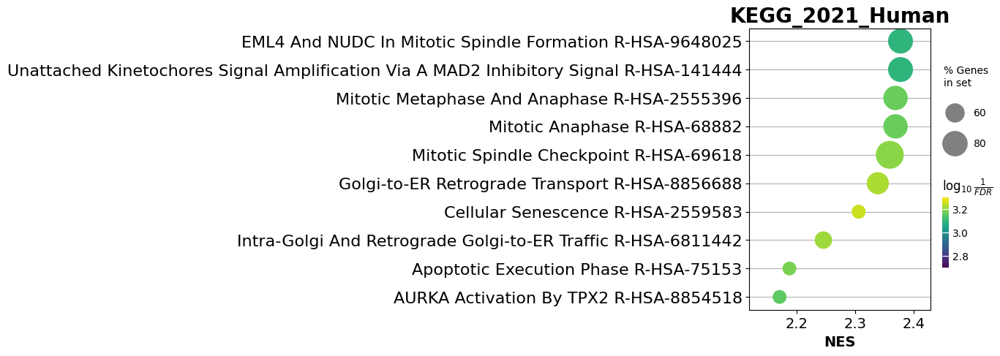

In [417]:
ax = dotplot(res.res2d,
column="FDR q-val",
title='KEGG_2021_Human',
cmap=plt.cm.viridis,
size=5,
figsize=(4,5), cutoff=2,     n_terms=15)

## Plot pathway network

In [572]:
import networkx as nx

In [573]:
res.res2d.head(20)


,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Transcriptional Regulation By TP53 R-HSA-3700989,0.746148,2.545085,0.0,0.0,0.0,10/26,16.86%,CDC25C;CDK1;AURKA;BIRC5;CCNB1;TPX2;BRIP1;CCNE2...
1,gsea,RHO GTPase Effectors R-HSA-195258,0.818143,2.532133,0.0,0.0,0.0,25/38,13.40%,SPC25;KIF14;CDC25C;KIF2C;KNL1;BUB1B;NUF2;CDCA8...
2,gsea,"Cell Cycle, Mitotic R-HSA-69278",0.803887,2.445504,0.0,0.00077,0.001,51/65,17.61%,SPC25;CDC25C;NEK2;KIF2C;CDK1;HMMR;GTSE1;KNL1;B...
3,gsea,Mitotic Prometaphase R-HSA-68877,0.841351,2.427933,0.0,0.000578,0.001,26/34,12.29%,SPC25;NEK2;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BU...
4,gsea,Cell Cycle Checkpoints R-HSA-69620,0.83329,2.392442,0.001789,0.000462,0.001,31/39,12.23%,SPC25;CDC25C;KIF2C;CDK1;GTSE1;KNL1;BUB1B;NUF2;...
5,gsea,RHO GTPases Activate Formins R-HSA-5663220,0.864432,2.318402,0.0,0.000385,0.001,21/26,12.23%,SPC25;KIF2C;KNL1;BUB1B;NUF2;CDCA8;BUB1;CENPE;C...
6,gsea,M Phase R-HSA-68886,0.788177,2.307988,0.0,0.00066,0.001,30/44,13.40%,SPC25;NEK2;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BU...
7,gsea,Regulation Of TP53 Activity R-HSA-5633007,0.827814,2.286828,0.0,0.000578,0.001,4/10,7.39%,CDK1;AURKA;TPX2;BRIP1
8,gsea,Resolution Of Sister Chromatid Cohesion R-HSA-...,0.865409,2.241727,0.0,0.00077,0.002,23/27,12.23%,SPC25;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BUB1;CE...
9,gsea,Mitotic Metaphase And Anaphase R-HSA-2555396,0.822786,2.238791,0.0,0.00063,0.002,26/35,12.29%,SPC25;KIF2C;CDK1;KNL1;BUB1B;NUF2;CDCA8;BUB1;CE...


In [574]:
help(gp.enrichment_map)

Help on function enrichment_map in module gseapy.plot:

enrichment_map(df: pandas.core.frame.DataFrame, column: str = 'Adjusted P-value', cutoff: float = 0.05, top_term: int = 10, **kwargs) -> Tuple[pandas.core.frame.DataFrame, pandas.core.frame.DataFrame]
    Visualize GSEApy Results.
    Node size corresponds to the percentage of gene overlap in a certain term of interest.
    Colour of the node corresponds to the significance of the enriched terms.
    Edge size corresponds to the number of genes that overlap between the two connected nodes.
    Gray edges correspond to both nodes when it is the only colour edge.
    When there are two different edge colours, red corresponds to positve nodes and blue corresponds to negative nodes.
    
    :param df: GSEApy DataFrame results.
    :param column: column name in `df` to map the node colors. Default: Adjusted P-value or FDR q-val.
                   choose from ("Adjusted P-value", "P-value", "FDR q-val", "NOM p-val").
    
    :param g

In [575]:
top_res = res.res2d.sort_values(by='NES', ascending=False).head(115)

# Generate the enrichment map using the top 20 pathways
nodes, edges = gp.enrichment_map(top_res, top_term=115)


/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()


In [576]:
nodes.head(40)


,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes,p_inv,Hits_ratio
node_idx,,,,,,,,,,,,
0,gsea,Metabolism Of Nucleotides R-HSA-15869,0.672244,1.75648,0.002933,0.025916,0.22,4/10,13.35%,RRM2;TK1;TYMS;RRM1,1.586430,0.400000
1,gsea,RHOA GTPase Cycle R-HSA-8980692,0.524171,1.765337,0.0064,0.023837,0.201,4/26,9.57%,ARHGAP11A;DIAPH3;ANLN;ECT2,1.622754,0.153846
2,gsea,RHOB GTPase Cycle R-HSA-9013026,0.573365,1.775325,0.0,0.021623,0.181,3/16,9.57%,DIAPH3;ANLN;ECT2,1.665082,0.187500
3,gsea,AURKA Activation By TPX2 R-HSA-8854518,0.7656,1.778247,0.00363,0.021188,0.172,6/11,12.29%,NEK2;CDK1;HMMR;AURKA;TPX2;TUBA4A,1.673906,0.545455
4,gsea,Regulation Of PLK1 Activity At G2/M Transition...,0.760745,1.78573,0.005405,0.020404,0.159,6/11,12.29%,NEK2;CDK1;AURKA;CCNB1;CCNB2;TUBA4A,1.690276,0.545455
5,gsea,DNA Damage/Telomere Stress Induced Senescence ...,0.682152,1.792504,0.0,0.019895,0.15,7/10,21.22%,H1-5;LMNB1;CCNE2;H1-3;H2AC20;CDKN1A;H2AZ1,1.701259,0.700000
6,gsea,DNA Repair R-HSA-73894,0.635195,1.883109,0.001513,0.008390,0.063,7/17,13.40%,DTL;CLSPN;BRIP1;KPNA2;UBE2T;PCLAF;H2AC20,2.076256,0.411765
7,gsea,G1/S Transition R-HSA-69206,0.823654,1.895578,0.003484,0.006579,0.046,13/15,16.86%,CDK1;RRM2;CDC6;CCNB1;TK1;CCNE2;MCM4;DBF4;TYMS;...,2.181860,0.866667
8,gsea,Intra-Golgi And Retrograde Golgi-to-ER Traffic...,0.823081,1.916265,0.0,0.004346,0.026,9/14,10.27%,KIF2C;KIF18B;KIF4A;CENPE;KIF23;KIF11;KIF18A;KI...,2.361960,0.642857


In [577]:
edges.head(100)


,src_idx,targ_idx,src_name,targ_name,jaccard_coef,overlap_coef,overlap_genes
0,0,7,Metabolism Of Nucleotides R-HSA-15869,G1/S Transition R-HSA-69206,0.214286,0.750000,"RRM2,TYMS,TK1"
1,0,12,Metabolism Of Nucleotides R-HSA-15869,Mitotic G1 Phase And G1/S Transition R-HSA-453279,0.187500,0.750000,"RRM2,TYMS,TK1"
2,0,22,Metabolism Of Nucleotides R-HSA-15869,"Cell Cycle, Mitotic R-HSA-69278",0.057692,0.750000,"RRM2,TYMS,TK1"
3,1,2,RHOA GTPase Cycle R-HSA-8980692,RHOB GTPase Cycle R-HSA-9013026,0.750000,1.000000,"ECT2,ANLN,DIAPH3"
4,1,30,RHOA GTPase Cycle R-HSA-8980692,RHO GTPase Effectors R-HSA-195258,0.035714,0.250000,DIAPH3
...,...,...,...,...,...,...,...
95,9,22,Deposition Of New CENPA-containing Nucleosomes...,"Cell Cycle, Mitotic R-HSA-69278",0.132075,0.777778,"KNL1,H2AC20,CENPI,CENPU,CENPA,CENPP,CENPK"
96,9,23,Deposition Of New CENPA-containing Nucleosomes...,Resolution Of Sister Chromatid Cohesion R-HSA-...,0.230769,0.666667,"KNL1,CENPI,CENPU,CENPA,CENPP,CENPK"
97,9,24,Deposition Of New CENPA-containing Nucleosomes...,M Phase R-HSA-68886,0.218750,0.777778,"KNL1,H2AC20,CENPI,CENPU,CENPA,CENPP,CENPK"
98,9,25,Deposition Of New CENPA-containing Nucleosomes...,Mitotic Metaphase And Anaphase R-HSA-2555396,0.206897,0.666667,"KNL1,CENPI,CENPU,CENPA,CENPP,CENPK"


In [578]:
import os

# Define the base path and file name
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/"
file_name = "enrichmap_reactome_leiden_3_vs_0_big.csv"
output_path = os.path.join(base_path, file_name)

# Select the top 100 edges
top_100_edges = edges

# Save the edges to a CSV file
top_100_edges.to_csv(output_path, index=False)

# Confirm save location
print(f"Edges saved to: {output_path}")

Edges saved to: /storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/enrichmap_reactome_leiden_3_vs_0_big.csv


In [579]:
# build graph
G = nx.from_pandas_edgelist(edges,
    source='src_idx',
    target='targ_idx',
    edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])


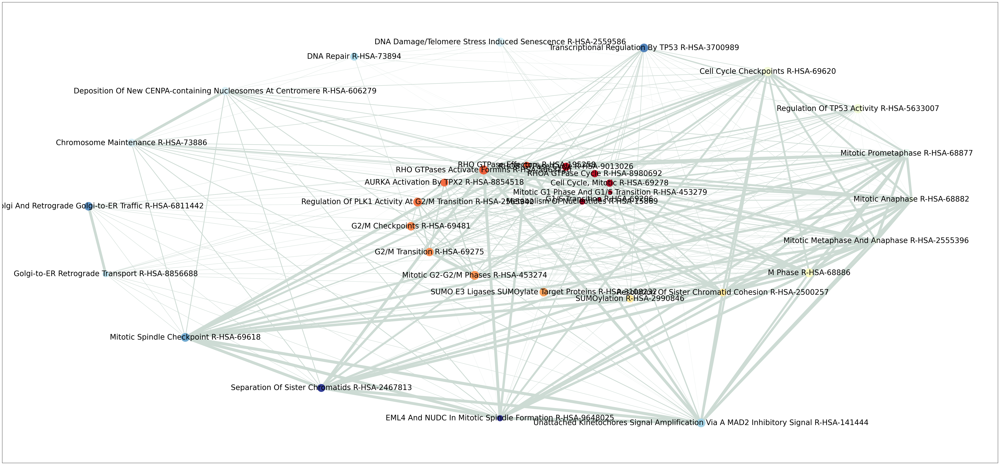

In [580]:
import matplotlib.pyplot as plt
import networkx as nx

fig, ax = plt.subplots(figsize=(60, 28))  # Increase the figure size

# Initialize node coordinates
pos = nx.layout.spiral_layout(G)

# Draw nodes
nx.draw_networkx_nodes(
    G,
    pos=pos,
    cmap=plt.cm.RdYlBu,
    node_color=list(nodes.NES),
    node_size=list(nodes.Hits_ratio * 1000)
)

# Draw node labels
nx.draw_networkx_labels(
    G,
    pos=pos,
    labels=nodes.Term.to_dict(),
    font_size=25  # Increase font size for better readability
)

# Draw edges
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(
    G,
    pos=pos,
    width=list(map(lambda x: x * 10, edge_weight)),
    edge_color='#CDDBD4'
)

plt.show()


Figure saved to: /storage/users/job37yv/Projects/single-cell_samantha/figures/res_gsea_hallmark/enrichmap_leiden_3_vs_0_big.png


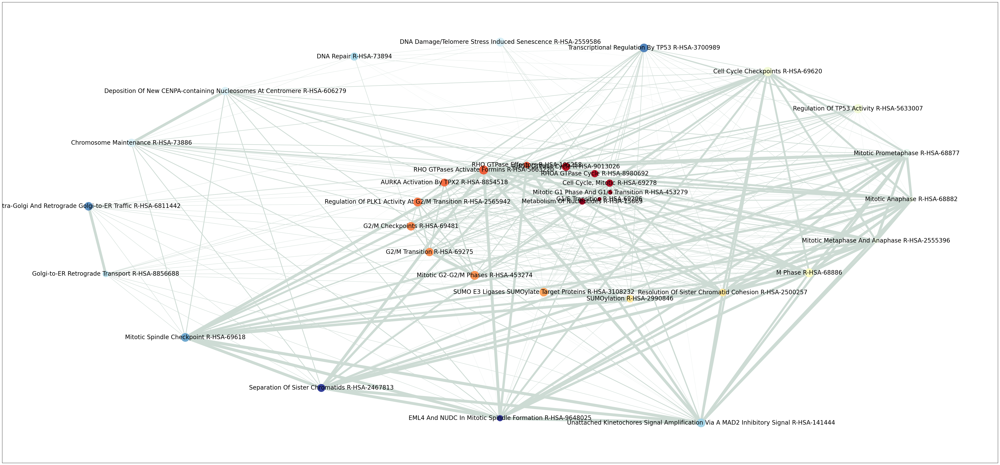

In [581]:
import matplotlib.pyplot as plt
import networkx as nx

# Define the base path and file name
base_path = "/storage/users/job37yv/Projects/single-cell_samantha/figures/res_gsea_hallmark/"
file_name = "enrichmap_leiden_3_vs_0_big.png"
output_path = base_path + file_name

# Create a figure and axis for the plot
fig, ax = plt.subplots(figsize=(60, 28))  # Increase the figure size

# Initialize node coordinates
pos = nx.layout.spiral_layout(G)

# Draw nodes
nx.draw_networkx_nodes(
    G,
    pos=pos,
    cmap=plt.cm.RdYlBu,
    node_color=list(nodes.NES),
    node_size=list(nodes.Hits_ratio * 1000)
)

# Draw node labels
nx.draw_networkx_labels(
    G,
    pos=pos,
    labels=nodes.Term.to_dict(),
    font_size=20  # Increase font size for better readability
)

# Draw edges
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(
    G,
    pos=pos,
    width=list(map(lambda x: x * 10, edge_weight)),
    edge_color='#CDDBD4'
)

# Save the figure
plt.savefig(output_path, dpi=300, bbox_inches='tight')
print(f"Figure saved to: {output_path}")

# Show the plot (optional)
plt.show()


In [428]:
Regulation Of PLK1 Activity At G2/M Transitio
AURKA Activation By TPX2 R-HSA-885451
Transcriptional Regulation By TP53 R-HSA-3700989	
RHO GTPases Activate Formins R-HSA-5663220
Mitotic G2-G2/M Phases R-HSA-45327
G2/M Transition R-HSA-692
Apoptotic Execution Phase R-HSA-7515
Golgi-to-ER Retrograde Transport R-HSA-8856688
Intra-Golgi And Retrograde Golgi-to-ER Traff
Cellular Senesecence
Mitotic Spindle Ckeckpint

SyntaxError: invalid syntax (1266033794.py, line 1)

In [ ]:
# Define patterns to match pathways
patterns = [
    "Regulation Of PLK1 Activity At G2/M Transitio",
    "AURKA Activation By TPX2 R-HSA-885451",
    "Transcriptional Regulation By TP53 R-HSA-3700989",
    "RHO GTPases Activate Formins R-HSA-5663220",
    "Mitotic G2-G2/M Phases R-HSA-45327",
    "G2/M Transition R-HSA-692",
    "Apoptotic Execution Phase R-HSA-7515",
    "Golgi-to-ER Retrograde Transport R-HSA-8856688",
    "Intra-Golgi And Retrograde Golgi-to-ER Traff",
    "Mitotic Anaphase",
    "Cellular Senesecence",
    "Mitotic Spindle Ckeckpint",
    "EML4 and NUDC in Mitotic"
]

# Filter res.res2d for matching terms
filtered_res2d = res.res2d[res.res2d['Term'].str.contains('|'.join(patterns), na=False, case=False)]

# Display the filtered rows
print("Filtered pathways:")
print(filtered_res2d)



In [435]:
# Generate the enrichment map
nodes, edges = gp.enrichment_map(filtered_res2d, top_term=17)
nodes.head(18)


/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/gseapy/plot.py:738: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[self.colname] = df[self.colname].replace(0, np.nan).bfill()


,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes,p_inv,Hits_ratio
node_idx,,,,,,,,,,,,
0,gsea,Regulation Of PLK1 Activity At G2/M Transition...,0.807406,2.157956,0.0,0.000390,0.003,5/11,7.16%,NEK2;CDK1;CCNB2;CCNB1;AURKA,3.409093,0.454545
1,gsea,AURKA Activation By TPX2 R-HSA-8854518,0.813067,2.170508,0.0,0.000209,0.002,5/11,7.16%,NEK2;CDK1;HMMR;TPX2;AURKA,3.680159,0.454545
2,gsea,Transcriptional Regulation By TP53 R-HSA-3700989,0.776767,2.650127,0.0,0.000112,0.0,8/26,7.16%,CDK1;CDC25C;BRIP1;BIRC5;CCNE2;TPX2;CCNB1;AURKA,3.949005,0.307692
3,gsea,RHO GTPases Activate Formins R-HSA-5663220,0.871977,2.474872,0.0,0.000112,0.0,19/26,8.14%,SPC25;KIF2C;NUF2;BUB1B;DIAPH3;KNL1;BUB1;ZWINT;...,3.949005,0.730769
4,gsea,EML4 And NUDC In Mitotic Spindle Formation R-H...,0.88165,2.377013,0.0,0.000112,0.0,18/22,8.14%,SPC25;KIF2C;NUF2;BUB1B;KNL1;BUB1;ZWINT;BIRC5;K...,3.949005,0.818182
5,gsea,Golgi-to-ER Retrograde Transport R-HSA-8856688,0.896638,2.338236,0.0,0.000112,0.0,8/11,7.58%,KIF18B;KIF2C;KIF23;KIF4A;KIF11;KIF18A;CENPE;KI...,3.949005,0.727273
6,gsea,Mitotic G2-G2/M Phases R-HSA-453274,0.860248,2.384413,0.0,0.000112,0.0,11/18,7.22%,NEK2;CDK1;CDC25C;GTSE1;HMMR;MYBL2;TPX2;CCNB2;C...,3.949005,0.611111
7,gsea,G2/M Transition R-HSA-69275,0.860248,2.384413,0.0,0.000112,0.0,11/18,7.22%,NEK2;CDK1;CDC25C;GTSE1;HMMR;MYBL2;TPX2;CCNB2;C...,3.949005,0.611111
8,gsea,Apoptotic Execution Phase R-HSA-75153,0.791544,2.187347,0.0,0.000112,0.001,5/11,13.40%,H1-5;CLSPN;LMNB1;HMGB2;H1-3,3.949005,0.454545


In [445]:
sorted_edges = edges.sort_values(by='jaccard_coef', ascending=False).head(50)
sorted_edges.head(50)
edges = sorted_edges.head(20)
edges.head(20)


,src_idx,targ_idx,src_name,targ_name,jaccard_coef,overlap_coef,overlap_genes
20,5,9,Golgi-to-ER Retrograde Transport R-HSA-8856688,Intra-Golgi And Retrograde Golgi-to-ER Traffic...,1.000000,1.000000,"KIF4A,KIF11,KIF2C,KIF20B,CENPE,KIF23,KIF18B,KI..."
21,6,7,Mitotic G2-G2/M Phases R-HSA-453274,G2/M Transition R-HSA-69275,1.000000,1.000000,"CENPF,GTSE1,CCNB1,MYBL2,AURKA,CDK1,HMMR,CDC25C..."
11,3,4,RHO GTPases Activate Formins R-HSA-5663220,EML4 And NUDC In Mitotic Spindle Formation R-H...,0.947368,1.000000,"NUF2,KNL1,CENPF,KIF2C,SGO2,BUB1,CDC20,BIRC5,CE..."
5,1,6,AURKA Activation By TPX2 R-HSA-8854518,Mitotic G2-G2/M Phases R-HSA-453274,0.454545,1.000000,"AURKA,CDK1,HMMR,NEK2,TPX2"
3,0,7,Regulation Of PLK1 Activity At G2/M Transition...,G2/M Transition R-HSA-69275,0.454545,1.000000,"CCNB1,AURKA,CDK1,NEK2,CCNB2"
2,0,6,Regulation Of PLK1 Activity At G2/M Transition...,Mitotic G2-G2/M Phases R-HSA-453274,0.454545,1.000000,"CCNB1,AURKA,CDK1,NEK2,CCNB2"
6,1,7,AURKA Activation By TPX2 R-HSA-8854518,G2/M Transition R-HSA-69275,0.454545,1.000000,"AURKA,CDK1,HMMR,NEK2,TPX2"
0,0,1,Regulation Of PLK1 Activity At G2/M Transition...,AURKA Activation By TPX2 R-HSA-8854518,0.428571,0.600000,"CDK1,NEK2,AURKA"
10,2,7,Transcriptional Regulation By TP53 R-HSA-3700989,G2/M Transition R-HSA-69275,0.357143,0.625000,"CCNB1,AURKA,CDK1,CDC25C,TPX2"
9,2,6,Transcriptional Regulation By TP53 R-HSA-3700989,Mitotic G2-G2/M Phases R-HSA-453274,0.357143,0.625000,"CCNB1,AURKA,CDK1,CDC25C,TPX2"


In [439]:
# Save edges to CSV
base_path_data = "/storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/"
file_name_data = "enrichmap_reactome_leiden_2_vs_1_zoomed.csv"
output_path_data = os.path.join(base_path_data, file_name_data)

edges.to_csv(output_path_data, index=False)
print(f"Edges saved to: {output_path_data}")

Edges saved to: /storage/users/job37yv/Projects/single-cell_samantha/data/res_gsea_hallmark/enrichmap_reactome_leiden_2_vs_1_zoomed.csv


In [446]:
# Build graph
G = nx.from_pandas_edgelist(
    edges,
    source='src_idx',
    target='targ_idx',
    edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes']
)


In [447]:
# Plot the graph
base_path_fig = "/storage/users/job37yv/Projects/single-cell_samantha/figures/res_gsea_hallmark/"
file_name_fig = "enrichmap_leiden_2_vs_1_zoomed.png"
output_path_fig = os.path.join(base_path_fig, file_name_fig)

In [448]:
print(f"Number of nodes in G: {len(G.nodes)}")
print(f"Length of nodes.NES: {len(nodes.NES)}")
print(f"Length of nodes.Hits_ratio: {len(nodes.Hits_ratio)}")

Number of nodes in G: 9
Length of nodes.NES: 10
Length of nodes.Hits_ratio: 10


In [ ]:
# Identify unique indices from edges
edge_indices = set(edges['src_idx']).union(set(edges['targ_idx']))

# Filter nodes to include only those present in edges
filtered_nodes = nodes[nodes.index.isin(edge_indices)]

# Verify consistency
print(f"Number of nodes after filtering: {len(filtered_nodes)}")
print(f"Number of edges: {len(edges)}")

# Verify consistency after filtering
print(f"Number of nodes in G: {len(G.nodes)}")
print(f"Length of filtered_nodes.NES: {len(filtered_nodes.NES)}")
print(f"Length of filtered_nodes.Hits_ratio: {len(filtered_nodes.Hits_ratio)}")

# Prepare node attributes
node_color = list(filtered_nodes['NES'])  # Match filtered nodes
node_size = list(filtered_nodes['Hits_ratio'] * 1000)  # Scale node sizes


In [455]:
import textwrap

Figure saved to: /storage/users/job37yv/Projects/single-cell_samantha/figures/res_gsea_hallmark/enrichmap_leiden_2_vs_1_sm.png


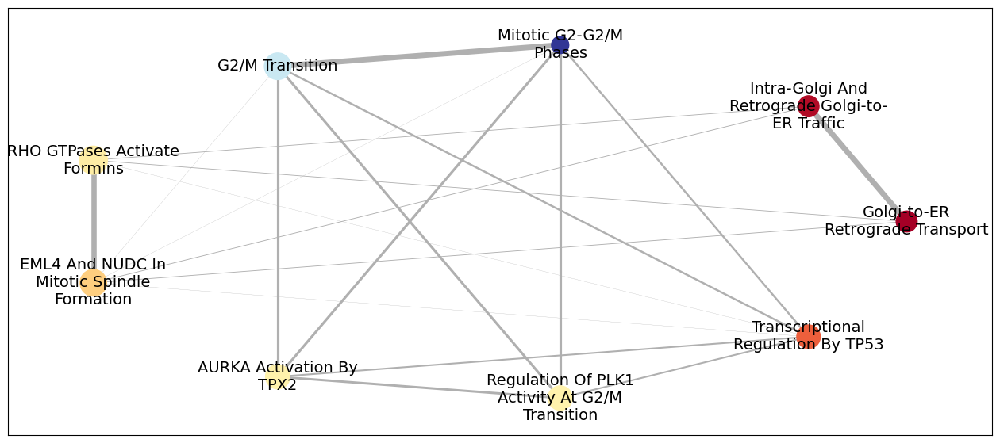

In [458]:
# Create a figure and axis for the plot
fig, ax = plt.subplots(figsize=(16, 7))  # Adjust figure size for compactness

# Initialize node coordinates using a circular layout for compact representation
pos = nx.layout.circular_layout(G)


import textwrap

# Define a function to wrap text
def wrap_text(label, width=20):
    return '\n'.join(textwrap.wrap(label, width))

# Shorten the labels by removing everything after and including "R-HSA-*"
shortened_labels = filtered_nodes['Term'].str.replace(r'R-HSA-.*$', '', regex=True)

# Wrap the shortened labels
wrapped_labels = shortened_labels.apply(wrap_text).to_dict()


# Initialize node coordinates using a circular layout for compact representation
pos = nx.layout.circular_layout(G)

# Draw nodes with adjusted size
nx.draw_networkx_nodes(
    G,
    pos=pos,
    cmap=plt.cm.RdYlBu,
    node_color=list(filtered_nodes.NES),
    node_size=list(filtered_nodes.Hits_ratio * 800)  # Reduce size for compactness
)

# Draw node labels with wrapped terms
nx.draw_networkx_labels(
    G,
    pos=pos,
    labels=wrapped_labels,
    font_size=14,  # Adjust font size as needed
    verticalalignment="center"  # Center the labels better
)

# Draw edges with reduced width
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(
    G,
    pos=pos,
    width=list(map(lambda x: x * 5, edge_weight)),  # Reduce edge thickness
    edge_color='#B0B0B0'  # Lighter edge color for better contrast
)

# Save the figure
plt.savefig(output_path, dpi=300, bbox_inches='tight')
print(f"Figure saved to: {output_path}")

# Show the plot
plt.show()


### Network Plot

In [215]:
import reactome2py.analysis as analysis
print(dir(analysis))

['ConnectionError', 'NumberTypes', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__spec__', 'compare_species', 'csv', 'db_name', 'db_version', 'found_entities', 'identifier', 'identifiers', 'identifiers_form', 'identifiers_mapping', 'identifiers_mapping_form', 'identifiers_mapping_url', 'identifiers_url', 'import_form', 'import_json', 'import_url', 'pandas', 'pathway2df', 'print_function', 'report', 'requests', 'result2json', 'token', 'token_filter_species', 'token_pathway_page', 'token_pathway_reactions', 'token_pathway_summary', 'token_pathways_binned', 'token_pathways_reactions', 'token_pathways_result', 'token_pathways_summary', 'token_resources', 'token_unfound_identifiers', 'unfound_entities', 'unicode_literals']


In [217]:
from reactome2py.analysis import token, token_pathways_summary
import matplotlib.pyplot as plt

# Example gene list for pathway analysis
gene_list = "TP53,BRCA1,EGFR,MTOR,MAPK1"
species = "Homo sapiens"

# Submit gene list for Reactome analysis
response = token.post_ids(ids=gene_list, species=species)

# Extract the analysis token
analysis_token = response['summary']['token']
print(f"Analysis Token: {analysis_token}")

# Retrieve pathway summaries
pathways_summary = token_pathways_summary(analysis_token)
print("Pathway Summary:")
for pathway in pathways_summary['pathways'][:5]:  # Show top 5 pathways
    print(f"Pathway: {pathway['name']}, Identifier: {pathway['dbId']}")


AttributeError: 'function' object has no attribute 'post_ids'

In [216]:
from reactome2py.content import pathway
import matplotlib.pyplot as plt

# Extract Reactome pathway IDs from the GSEA results
pathway_ids = res.res2d.Term.tolist()  # Assuming Reactome pathway names/IDs are in the Term column

# Select the top pathway
top_pathway_id = pathway_ids[0]  # Replace with the desired pathway ID from your results

# Fetch the pathway diagram as a PNG
diagram_info = pathway.get_pathway_diagram_png(top_pathway_id)

# Save the pathway diagram as an image
file_name = f"reactome_{top_pathway_id}.png"
with open(file_name, "wb") as f:
    f.write(diagram_info)

# Load and display the pathway diagram
img = plt.imread(file_name)
plt.figure(figsize=(12, 8))  # Adjust figure size as needed
plt.imshow(img)
plt.axis('off')
plt.title(f"Reactome Pathway Diagram: {top_pathway_id}")
plt.show()



ImportError: cannot import name 'pathway' from 'reactome2py.content' (/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/reactome2py/content.py)

In [211]:

# Load and display the pathway diagram
img = plt.imread(f"reactome_{top_pathway_id}.png")
plt.figure(figsize=(12, 8))
plt.imshow(img)
plt.axis('off')
plt.title(f"Reactome Pathway Diagram: {top_pathway_id}")
plt.show()



ImportError: cannot import name 'identify' from 'reactome2py.analysis' (/home/job37yv/miniforge3/envs/gsea/lib/python3.9/site-packages/reactome2py/analysis.py)

In [210]:
for pathway_id in pathway_ids:
    # Fetch and save pathway diagram
    diagram_info = visualization.get_pathway_diagram_png(pathway_id)
    with open(f"reactome_{pathway_id}.png", "wb") as f:
        f.write(diagram_info.content)

    # Load and display
    img = plt.imread(f"reactome_{pathway_id}.png")
    plt.figure(figsize=(12, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Reactome Pathway Diagram: {pathway_id}")
    plt.show()


NameError: name 'pathway_ids' is not defined

In [218]:
from reactome2py import analysis

# Input biomarkers
markers = 'RAS,MAP,IL10,EGF,EGFR,STAT'

# Perform enrichment analysis
result = analysis.identifiers(ids=markers)
token = result['summary']['token']
print(f"Analysis Token: {token}")


Analysis Token: MjAyNDEyMTcxNjQ3MTJfNzIxMg%3D%3D


In [219]:
import webbrowser

# Reactome web portal URL with the analysis token
url = f"https://reactome.org/PathwayBrowser/#/DTAB=AN&ANALYSIS={token}"
webbrowser.open(url)


>4;1H8TPS connection to reactome.org                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  

True

In [220]:
import os
from reactome2py import analysis

# Create a directory to save the report
if not os.path.exists('full-report/'):
    os.makedirs('full-report/')

# Save the report
analysis.report(
    token=token,
    path='full-report/',
    file='report.pdf',
    number='25',  # Number of pathways to include
    resource='TOTAL',
    diagram_profile='Modern',
    analysis_profile='Standard',
    fireworks_profile='Barium Lithium',
    species='Homo sapiens',
    chunk_size=128
)
print("Full report saved to 'full-report/report.pdf'")


Full report saved to 'full-report/report.pdf'


In [221]:
# Fetch significant pathways
token_result = analysis.token(
    token=token,
    species='Homo sapiens',
    page_size='-1',
    page='-1',
    sort_by='ENTITIES_FDR',
    order='ASC',
    resource='TOTAL',
    p_value='0.05',
    include_disease=True
)

# Extract pathway names and IDs
pathways = token_result['pathways']
pathways_stId = [p['stId'] for p in pathways]
print("Significant Pathways:")
for pathway in pathways:
    print(f"Pathway: {pathway['name']}, Reactome ID: {pathway['stId']}")


Significant Pathways:
Pathway: PLCG1 events in ERBB2 signaling, Reactome ID: R-HSA-1251932
Pathway: Inhibition of Signaling by Overexpressed EGFR, Reactome ID: R-HSA-5638303
Pathway: Signaling by Overexpressed Wild-Type EGFR in Cancer, Reactome ID: R-HSA-5638302
Pathway: EGFR interacts with phospholipase C-gamma, Reactome ID: R-HSA-212718
Pathway: ERBB2 Activates PTK6 Signaling, Reactome ID: R-HSA-8847993
Pathway: SHC1 events in EGFR signaling, Reactome ID: R-HSA-180336
Pathway: ERBB2 Regulates Cell Motility, Reactome ID: R-HSA-6785631
Pathway: Constitutive Signaling by EGFRvIII, Reactome ID: R-HSA-5637810
Pathway: Signaling by EGFRvIII in Cancer, Reactome ID: R-HSA-5637812
Pathway: Signaling by ERBB2 ECD mutants, Reactome ID: R-HSA-9665348
Pathway: GAB1 signalosome, Reactome ID: R-HSA-180292
Pathway: GRB2 events in EGFR signaling, Reactome ID: R-HSA-179812
Pathway: GRB2 events in ERBB2 signaling, Reactome ID: R-HSA-1963640
Pathway: PI3K events in ERBB2 signaling, Reactome ID: R-HSA-19

In [222]:
from reactome2py import content

# Create directory for saving the fireworks diagram
if not os.path.exists('fireworks/'):
    os.makedirs('fireworks/')

# Save the fireworks diagram
content.export_fireworks(
    species='9606',  # Human species ID
    ext='png',
    file='fireworks_report',
    path='fireworks/',
    quality='10',
    resource='TOTAL',
    title=True,
    margin='15',
    token=token
)
print("Fireworks diagram saved to 'fireworks/fireworks_report.png'")


Fireworks diagram saved to 'fireworks/fireworks_report.png'


In [223]:
import itertools

# Fetch pathways with diagrams
fetch_downstream_pathways = [
    content.pathways_low_diagram(id=stId, species=None, all_forms=False) for stId in pathways_stId
]

downstream_pathways = [low_pathway for low_pathway in fetch_downstream_pathways if low_pathway is not None]
has_diagram = [p[0]['hasDiagram'] for p in downstream_pathways]
downstream_pathway_has_diagram = list(itertools.compress(downstream_pathways, has_diagram))
downstream_pathway_stId = [p[0]['stId'] for p in downstream_pathway_has_diagram]

# Create directory for saving diagrams
if not os.path.exists('diagrams/'):
    os.makedirs('diagrams/')

# Save each pathway diagram
for stId in downstream_pathway_stId:
    content.export_diagram(
        id=stId,
        ext='png',
        quality='5',
        flag_interactors=False,
        title=True,
        margin='15',
        ehld=True,
        diagram_profile='Modern',
        resource='TOTAL',
        analysis_profile='Standard',
        token=token,
        file=f"{stId}_report",
        path='diagrams/'
    )
print("Pathway diagrams saved to 'diagrams/'")


Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value of 404
Status code returned a value